# Embedding e análise de livros clássicos de domínio público em português

- Vetorização de sentenças em livros de domínio público.
- Clusterização com HDBSCAN.
- Classificação.

# Instalar pacotes

In [1]:
#%pip install pypdf
#%pip install sentence-transformers
#%pip install nltk
#%pip install sklearn
#%pip install hdbscan
#%pip install matplotlib
#%pip install seaborn
#%pip install wordcloud
#%pip install umap-learn
#%pip install chunkipy
#%pip install pymupdf
#%pip install pytesseract
#%pip install pillow

# Importar pacotes

In [2]:
import os
import fnmatch

from pypdf import PdfReader

import fitz  # PyMuPDF
from PIL import Image
import pytesseract

import string
import pickle
import re

from sentence_transformers import SentenceTransformer
import nltk
nltk.download('punkt_tab')
# Carregando o modelo para gerar embeddings
model = SentenceTransformer('all-MiniLM-L6-v2')

import numpy as np
from sklearn.cluster import DBSCAN, HDBSCAN
from sklearn.metrics import silhouette_score
import gc

from chunkipy import TextChunker

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

import matplotlib.pyplot as plt
from matplotlib.patches import Patch
import seaborn as sns

import umap.umap_ as umap

import pandas as pd

[nltk_data] Downloading package punkt_tab to
[nltk_data]     /home/mcarbonera/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!


# Extrair texto de PDF

In [3]:
# Método para extrair texto. Foi testado com pypdf sem OCR e depois PyMuPDF fallback para OCR com tesseract
def extract_text(pdf_path):
  #return extract_text_pypdf2(pdf_path)
  return extract_text_with_ocr_fallback(pdf_path)

# Extrair Texto com pypdf
def extract_text_pypdf2(pdf_path):
  text = ""
  with open(pdf_path, 'rb') as file:
    reader = PdfReader(file)
    for page in reader.pages:
      text += page.extract_text()
  return text

# Extrair texto com PyMuPDF e Tesseract (ESTE METODO ESTA SENDO USADO)
def is_garbage_text(text, WORDS_THRESHOLD=20):
  if not text.strip():
    return True

  # Heuristic 1: total length too small
  numCharacters = len(text.strip())
  if numCharacters < WORDS_THRESHOLD:
    print(f"[GARBAGE DETECTED] Very short text: '{numCharacters} characters'")
    return True

  # Heuristic 2: few alphabetic characters (real words)
  letters = re.findall(r'[a-zA-Z]', text)
  letter_ratio = len(letters) / (len(text) + 1e-5)
  if letter_ratio < 0.05:
    print(f"[GARBAGE DETECTED] Low alphabetic character ratio: {letter_ratio:.3f}")
    return True

  # Heuristic 3: too many control characters (like \x01, \x02, etc.)
  control_chars = re.findall(r'[\x00-\x1F\x7F]', text)
  control_ratio = len(control_chars) / (len(text) + 1e-5)
  if control_ratio > 0.3:
    print(f"[GARBAGE DETECTED] Too many control characters: {control_ratio:.3f}")
    return True

  # All checks passed — assume it's real text
  return False

def extract_text_from_page(page):
  """Try to extract text from a page using MuPDF."""
  text = page.get_text()

  if text and not is_garbage_text(text):
    return text.strip()

  # Fallback to OCR
  print(f"[OCR NEEDED] Using OCR for page.")
  pix = page.get_pixmap(dpi=300, alpha=False)
  img = Image.frombytes("RGB", [pix.width, pix.height], pix.samples)
  return pytesseract.image_to_string(img, lang="por")
  #return ""  # no text, no images = blank page or unsupported content

def extract_text_with_ocr_fallback(pdf_path):
  """Extract text from PDF with OCR fallback per page."""
  try:
    doc = fitz.open(pdf_path)
    full_text = ""
    for i, page in enumerate(doc):
      print(f"[PROCESSING] Processing page {i+1} of {len(doc)} in '{pdf_path}'...")
      page_text = extract_text_from_page(page)
      full_text += page_text + "\n"
    return full_text.strip()
  except Exception as e:
    print(f"[ERROR] Error processing {pdf_path}: {e}")
    return ""

In [4]:
livros = []
def list_files(directory, filetype):
  for file in os.listdir(directory):
    if fnmatch.fnmatch(file, filetype):
      livros.append(file)
    else:
      print('Livro em formato errado: ', file)

list_files(os.getcwd()+'/livros', '*.pdf')

In [5]:
extracted_text = []
num_livros=len(livros)
idx_livro = 1
for livro in livros:
  content = extract_text('livros/'+livro)
  extracted_text.append(content)
  print('Texto extraído: ('+str(idx_livro)+'/'+str(num_livros)+')')
  idx_livro=idx_livro+1

[PROCESSING] Processing page 1 of 180 in 'livros/14 de Julho na Roça14-de-Juho-na-Roca-Raul-Pompeia.pdf'...
[PROCESSING] Processing page 2 of 180 in 'livros/14 de Julho na Roça14-de-Juho-na-Roca-Raul-Pompeia.pdf'...
[PROCESSING] Processing page 3 of 180 in 'livros/14 de Julho na Roça14-de-Juho-na-Roca-Raul-Pompeia.pdf'...
[PROCESSING] Processing page 4 of 180 in 'livros/14 de Julho na Roça14-de-Juho-na-Roca-Raul-Pompeia.pdf'...
[PROCESSING] Processing page 5 of 180 in 'livros/14 de Julho na Roça14-de-Juho-na-Roca-Raul-Pompeia.pdf'...
[PROCESSING] Processing page 6 of 180 in 'livros/14 de Julho na Roça14-de-Juho-na-Roca-Raul-Pompeia.pdf'...
[PROCESSING] Processing page 7 of 180 in 'livros/14 de Julho na Roça14-de-Juho-na-Roca-Raul-Pompeia.pdf'...
[PROCESSING] Processing page 8 of 180 in 'livros/14 de Julho na Roça14-de-Juho-na-Roca-Raul-Pompeia.pdf'...
[PROCESSING] Processing page 9 of 180 in 'livros/14 de Julho na Roça14-de-Juho-na-Roca-Raul-Pompeia.pdf'...
[PROCESSING] Processing page

## Salvar conteúdo para continuar depois

In [6]:
# Saving objects:
with open('extracted_text.pkl', 'wb') as f:
  pickle.dump(extracted_text, f)

## Carregar conteúdo para continuar

In [3]:
# Getting back objects:
with open('extracted_text.pkl', 'rb') as f:
  extracted_text = pickle.load(f)

# Etapa de chunking

In [4]:
text_chunker = TextChunker(50, tokens=True, overlap_percent=0.3)

# Split com NLTK
def splitNLTK(text):
  sentences = nltk.sent_tokenize(text)
  return sentences

# Split com Chunkipy
def splitChunkipy(text):
  sentences = text_chunker.chunk(text)
  return sentences

# Splitting Text into Sentences
def split_text_into_sentences(text):
  return splitNLTK(text)
  #return splitChunkipy(text)

In [5]:
countSentencasPorLivro = []

sentences = []
for text in extracted_text:
  sentencesFromText = split_text_into_sentences(text)
  sentences = sentences + sentencesFromText

  countSentencasPorLivro.append(len(sentencesFromText))
sentences = [x.replace('\n', ' ') for x in sentences]
sentences = [re.sub('[ \t]+' , ' ', x) for x in sentences]
print(len(sentences))

536837


## Sentenças únicas

In [6]:
from collections import OrderedDict
unique_sentences = list(OrderedDict.fromkeys(sentences))
print(len(unique_sentences))
unique_sentences

487230


['14 DE JULHO NA ROÇA Raul Pompéia (A.G. da S.) 14 de julho é a grande data.',
 'Ecoa na história com as mesmas vibrações que deve proferir sobre o mundo a trombeta de Josafá, em plena consumação dos séculos.',
 'A Marselhesa é o gemido humano chamado às armas.',
 'A queda da Bastilha é o pavoroso esboroamento do passado, batido pelo futuro.',
 'A pirâmide da opressão tinha por base o grande cárcere e por vértice a coroa do rei; o povo devasta a pirâmide de alto a baixo; arrasa o alicerce, aniquila o píncaro.',
 'Cai a Bastilha, morre Luís XVI.',
 'Do cataclisma ergueu-se sangrenta a grande mão do direito humano saciado, e abriu os dedos sobre aquele caos, como as irradiações de uma estrela grandiosa e serena.',
 'À luz deste sol, começou a desfilar a procissão dos séculos... Curvado um dia sobre essas páginas épicas da lenda das gerações, inclinado à beira vertiginosa do báratro onde revoluteiam os fantasmas indistintos e medonhos daquele terremoto social, refletindo na humanidade e n

### Tamanho médio do chunk:

In [7]:
tamanhoMedioSentencas = sum([len(x) for x in sentences])/len(sentences)
tamanhoMedioSentencasUnicas = sum([len(x) for x in unique_sentences])/len(unique_sentences)

print('Sentenças: ', len(sentences))
print('Sentenças únicas: ', len(unique_sentences))
print('Tamanho médio das sentenças: ', tamanhoMedioSentencas)
print('Tamanho médio das sentenças únicas: ', tamanhoMedioSentencasUnicas)

sentencasUtilizadas = unique_sentences
#sentencasUtilizadas = sentences

Sentenças:  536837
Sentenças únicas:  487230
Tamanho médio das sentenças:  104.07458316025162
Tamanho médio das sentenças únicas:  110.7496644295302


## Verificar se sentenças não contém caracteres inválidos

In [14]:
idxLimitePorLivro = np.array(countSentencasPorLivro).cumsum()

def verificar_lixo(text):
  if not text.strip():
    return True
  printable_text = ''.join(c for c in text if c in string.printable)
  letters = re.findall(r'[a-zA-Z0-9]', printable_text)
  letter_ratio = len(letters) / (len(printable_text) + 1e-5)
  if letter_ratio < 0.1:
    return True
  return False

def livroDaSentenca(idxSentenca):
  return livros[len(idxLimitePorLivro[idxLimitePorLivro < idxSentenca])]

sentencas_problema = []
for idxSentence in range(len(sentencasUtilizadas)):
  sentence = sentencasUtilizadas[idxSentence]
  if(verificar_lixo(sentence)):
    sentencas_problema.append(idxSentence)

for idx in sentencas_problema:
  print(idx, ' - ', livroDaSentenca(idx), ' - Sentença: ', sentencasUtilizadas[idx])

4690  -  A Alma do LázaroA-Alma-do-Lazar-Jose-de-Alencar.pdf  - Sentença:  .
9706  -  A AlmanjarraA-ALMANJARRA-de-Artur-Azevedo.pdf  - Sentença:  ...
17387  -  A Brasileira de PrazinsA-Brasileira-de-Prazins-Camilo-Castelo-Branco.pdf  - Sentença:  ... **************************************************************************************************************** Na margem "VAMOS!
17431  -  A Brasileira de PrazinsA-Brasileira-de-Prazins-Camilo-Castelo-Branco.pdf  - Sentença:  ."
17476  -  A Brasileira de PrazinsA-Brasileira-de-Prazins-Camilo-Castelo-Branco.pdf  - Sentença:  !..."
17635  -  A Brasileira de PrazinsA-Brasileira-de-Prazins-Camilo-Castelo-Branco.pdf  - Sentença:  *************************************************************************************************************** Anjo "AI!
17945  -  A Brasileira de PrazinsA-Brasileira-de-Prazins-Camilo-Castelo-Branco.pdf  - Sentença:  !...
23729  -  A CarneA-Carne-de-Julio-Ribeiro.pdf  - Sentença:  – É.
23814  -  A CarneA-Carne-de-J

# Embeddings

In [15]:
embeddings = model.encode(sentencasUtilizadas, normalize_embeddings=True)
print(embeddings)
print(embeddings.shape)

[[-0.02441526  0.05254333 -0.02499201 ...  0.03464334 -0.05616045
  -0.00772223]
 [ 0.00073922  0.06588344 -0.081729   ... -0.00991633  0.05835766
  -0.03493027]
 [-0.00195835  0.13307045 -0.07305329 ...  0.00116208 -0.03743099
   0.01747464]
 ...
 [ 0.02727215  0.03703064 -0.02222078 ...  0.08582583 -0.00162526
  -0.00047289]
 [-0.02279284  0.02748208  0.0320675  ...  0.08901528  0.07063097
   0.01585232]
 [ 0.05199424  0.06966144 -0.06555378 ...  0.05508378  0.02939292
  -0.02486897]]
(487230, 384)


## Save embeddings

In [16]:
with open('embeddings.pkl', 'wb') as f:
  pickle.dump(embeddings, f)

## Load embeddings

In [8]:
with open('embeddings.pkl', 'rb') as f:
  embeddings = pickle.load(f)

# HDBSCAN

In [4]:
def printDict(dict):
  for k,v in dict.items():
    print('  - ', k, v)

# Hiperparametros
def get_hyperparameters(min_samples, min_cluster_size):
  param = {
    'metric': 'euclidean',
    'min_samples': min_samples,
    'min_cluster_size': min_cluster_size
  }
  return param

def applyHDBSCAN(param, paramEmbedding=embeddings):
  try:
    hdbscan_model = HDBSCAN(**param)
    hdbscan_model.fit(paramEmbedding)
    clusters = hdbscan_model.labels_
    probs = hdbscan_model.probabilities_
    # Compute the silhouette scores
    score = silhouette_score(paramEmbedding, clusters, metric='euclidean')
    unique, counts = np.unique(clusters, return_counts=True)

    print('---')
    print('Parameter:')
    printDict(param)
    print('Score:')
    print(score)
    print('Clusters:')
    printDict(dict(zip(unique, counts)))
    print('---')
    # Clean the memory
    del hdbscan_model
    gc.collect()
    return param, score, clusters, probs, unique, counts
  except Exception as err:
    print(f"Something went wrong when clustering the embeddings with {param}")
    print(f"Unexpected Error {err}, {type(err)}")

In [5]:
print('Aplicando UMAP')
umap_embeddings = umap.UMAP(
  n_neighbors=15,
  n_components=50,
  metric='cosine'
).fit_transform(embeddings)

Aplicando UMAP


/mnt/c/Users/marce/Desktop/Pos Graduacoes/UFSCAR - MachineLearningInProduction/AtividadesEntregas/3_EML3/2_entrega/.venv/lib/python3.12/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


In [6]:
param = get_hyperparameters(3, 100)
#param, score, clusters, probs, unique, counts = applyHDBSCAN(param)

print('Aplicando HDBSCAN')
param, score, clusters, probs, unique, counts = applyHDBSCAN(param, umap_embeddings)

Aplicando HDBSCAN
---
Parameter:
  -  metric euclidean
  -  min_samples 3
  -  min_cluster_size 100
Score:
0.09158369898796082
Clusters:
  -  -1 191734
  -  0 315
  -  1 2760
  -  2 547
  -  3 117
  -  4 100
  -  5 189
  -  6 358
  -  7 212
  -  8 432
  -  9 239
  -  10 2318
  -  11 140
  -  12 155
  -  13 235
  -  14 393
  -  15 122
  -  16 137
  -  17 177
  -  18 219
  -  19 163
  -  20 111
  -  21 110
  -  22 1470
  -  23 159
  -  24 230
  -  25 163
  -  26 146
  -  27 380
  -  28 260
  -  29 100
  -  30 6108
  -  31 359
  -  32 251
  -  33 319
  -  34 142
  -  35 123
  -  36 158
  -  37 230
  -  38 227
  -  39 169
  -  40 195
  -  41 165
  -  42 291
  -  43 102
  -  44 197
  -  45 123
  -  46 276
  -  47 230
  -  48 181
  -  49 104
  -  50 135
  -  51 817
  -  52 203
  -  53 163
  -  54 294
  -  55 267
  -  56 529
  -  57 120
  -  58 138
  -  59 554
  -  60 457
  -  61 116
  -  62 221
  -  63 190
  -  64 110
  -  65 224
  -  66 278
  -  67 241
  -  68 372
  -  69 152
  -  70 414
  

## Save resultado HDBSCAN

In [7]:
savedResultHDBSCAN = [param, score, clusters, probs, unique, counts]
with open('savedResultHDBSCAN.pkl', 'wb') as f:
  pickle.dump(savedResultHDBSCAN, f)

## Load resultado HDBSCAN

In [9]:
with open('savedResultHDBSCAN.pkl', 'rb') as f:
  param, score, clusters, probs, unique, counts = pickle.load(f)

## Visualização

## PCA + TSNE

In [10]:
pca_50 = PCA(n_components=50)
pca_result_50 = pca_50.fit_transform(embeddings)

print('Cumulative explained variation for 50 principal components: {}'.format(np.sum(pca_50.explained_variance_ratio_)))

Cumulative explained variation for 50 principal components: 0.516669511795044


In [11]:
tsne = TSNE(n_components=2, verbose=0, perplexity=10, max_iter=300, metric='cosine')
tsne_pca_results = tsne.fit_transform(pca_result_50)

In [12]:
unique, counts = np.unique(clusters, return_counts=True)
clusterCountDict = dict(zip(unique, counts))
color = [-1 if x ==-1 else x if clusterCountDict[x] > 1000 else 999999 for x in clusters]
print(len(counts[counts > 1000]))

59


In [13]:
clustersSorted = sorted(zip(unique, counts), key=lambda x: x[1])
clustersSorted.reverse()
clustersSorted[0:10]

[(np.int64(-1), np.int64(191734)),
 (np.int64(30), np.int64(6108)),
 (np.int64(458), np.int64(5109)),
 (np.int64(283), np.int64(4276)),
 (np.int64(481), np.int64(3864)),
 (np.int64(277), np.int64(3402)),
 (np.int64(630), np.int64(3277)),
 (np.int64(419), np.int64(3234)),
 (np.int64(355), np.int64(3044)),
 (np.int64(601), np.int64(2841))]

In [14]:
colorUnique, colorCounts = np.unique(color, return_counts=True)
colorZip = zip(colorUnique,colorCounts)
colorSorted = sorted(colorZip, key=lambda x: x[1])
colorSorted.reverse()
colorLabel = [int(x[0]) for x in colorSorted]
colorSorted[0:10]

[(np.int64(-1), np.int64(191734)),
 (np.int64(999999), np.int64(177505)),
 (np.int64(30), np.int64(6108)),
 (np.int64(458), np.int64(5109)),
 (np.int64(283), np.int64(4276)),
 (np.int64(481), np.int64(3864)),
 (np.int64(277), np.int64(3402)),
 (np.int64(630), np.int64(3277)),
 (np.int64(419), np.int64(3234)),
 (np.int64(355), np.int64(3044))]

In [16]:
unique_labels = sorted(set(color))
base_palette = sns.color_palette("husl", 59)

label_color_map = {-1: "gray"}  # gray for noise
for i, label in enumerate(unique_labels[1:]):
  label_color_map[label] = base_palette[i]

legend_patches = [
  Patch(color=color, label=f'Cluster {label}')
  for label, color in sorted(label_color_map.items())
]

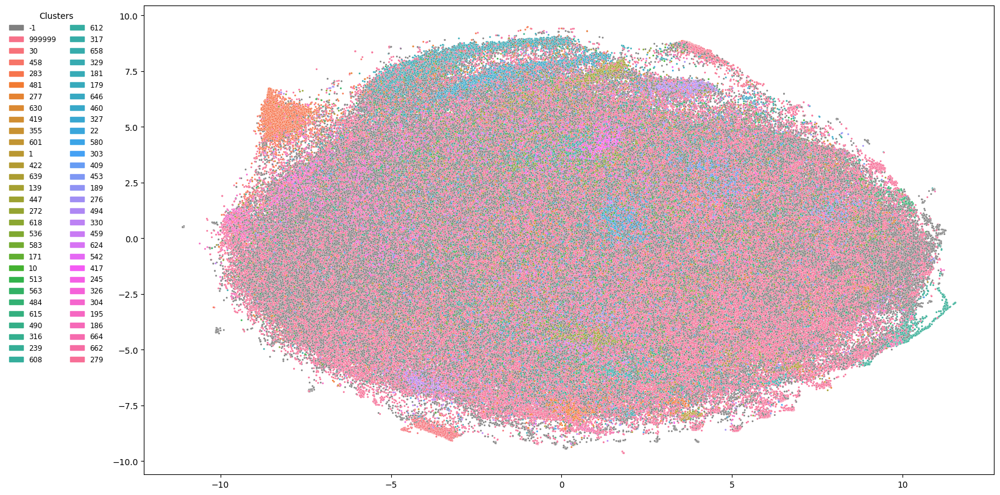

In [17]:
tsnex = tsne_pca_results[:,0]
tsney = tsne_pca_results[:,1]

plt.figure(figsize=(18,10))
sns.scatterplot(
  x=tsnex, y=tsney,
  hue=color,
  palette=label_color_map,
  s=5,
  legend="auto",
  alpha=1
)
plt.legend(
  title='Clusters',
  labels = colorLabel,
  ncol=2,
  handles=legend_patches,
  markerscale=2,
  frameon=False,
  fontsize='small',
  bbox_to_anchor=(-0.04, 1)
)

## UMAP:

In [18]:
def umap_reducer(embeddings):
  """reduced the embeddings to 2D with UMAP"""
  reducer = umap.UMAP(n_components=2, n_neighbors = 25, min_dist = 0.0, init = "random", metric = "cosine", random_state=0)
  umapped = reducer.fit_transform(embeddings)
  return umapped

In [19]:
umapped = umap_reducer(embeddings)

/mnt/c/Users/marce/Desktop/Pos Graduacoes/UFSCAR - MachineLearningInProduction/AtividadesEntregas/3_EML3/2_entrega/.venv/lib/python3.12/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/mnt/c/Users/marce/Desktop/Pos Graduacoes/UFSCAR - MachineLearningInProduction/AtividadesEntregas/3_EML3/2_entrega/.venv/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


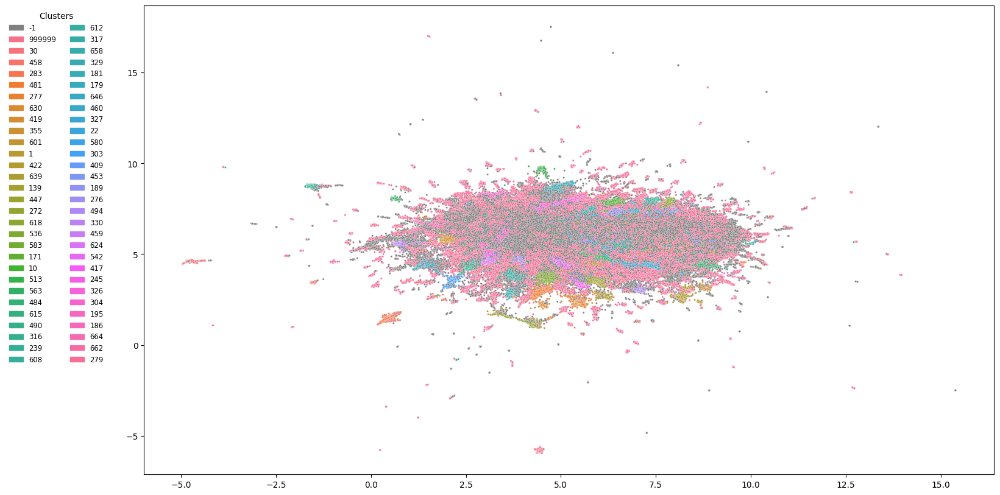

In [21]:
umapx = umapped[:,0]
umapy = umapped[:,1]

plt.figure(figsize=(18,10))
sns.scatterplot(
  x=umapx, y=umapy,
  hue=color,
  palette=label_color_map,
  s=5,
  legend="auto",
  alpha=1
)
plt.legend(
  title='Clusters',
  labels = colorLabel,
  ncol=2,
  handles=legend_patches,
  markerscale=2,
  frameon=False,
  fontsize='small',
  bbox_to_anchor=(-0.04, 1)
)

## Word Cloud

In [54]:
import re
from wordcloud import STOPWORDS, WordCloud
import matplotlib.pyplot as plt
import random

from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     /home/mcarbonera/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

### Remover stopwords (palavras que não carregam significado)

In [55]:
# Lista de stopwords em português
stopwords_pt = set(stopwords.words('portuguese'))

# Pré-processamento: tokenização + remoção de stopwords
tokensFiltrados = []
for s in sentencasUtilizadas:
  # transforma em minúsculas e tokeniza
  tokens = word_tokenize(s.lower())
  tokens_filtrados = [t for t in tokens if t.isalpha() and t not in stopwords_pt]
  tokensFiltrados.append(tokens_filtrados)

sentencasFiltradas = [' '.join(x) for x in tokensFiltrados]

In [ ]:
def printWordCloud(sentencas, titulo):
  text = ' '.join(sentencas)
  text = re.sub(r'[^A-Za-z\s]', '', text)
  text = text.lower()
  stopwords = set(STOPWORDS)
  text = ' '.join(word for word in text.split() if word not in stopwords)

  wordcloud = WordCloud(width=1200, height=600, background_color='white').generate(text)

  plt.figure(figsize=(16,10))
  plt.imshow(wordcloud, interpolation='bilinear')
  plt.axis('off')
  plt.title(titulo)
  plt.show()

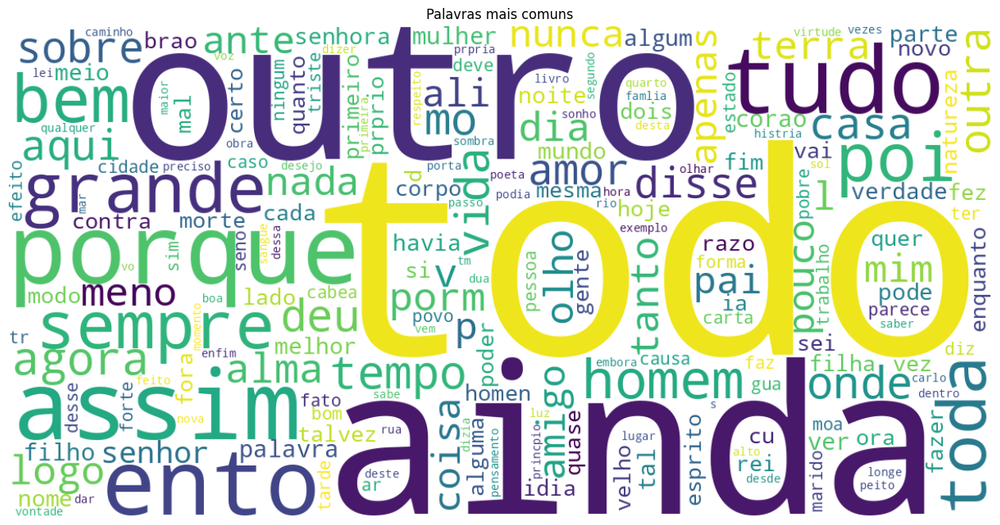

In [58]:
printWordCloud(sentencasFiltradas, 'Palavras mais comuns')

----- Cluster -1 -----
Níni Quero-te bem contudo.
Lembra-te que o casamento deve ser sempre a conseqüência de duas inclinações irresistíveis.
cuidava!...
Daí resulta que, por maior que seja a sua devoção, nunca se tornam nem um pouquinho mais sábios.
126 Vês neste grão terreno os diferentes Nomes de mil nações, nunca sabidas: Os Laos, em terra e número potentes; Avás, Bramás, por serras tão compridas; Vê nos remotos montes outras gentes, Que Gueos se chamam, de selvages vidas; Humana carne comem, mas a sua Pintam com ferro ardente, usança crua.
163 Era um tipo romântico de mosqueteiro, um d'Artagnan de olhos azuis, pele branca e macia, mãos delgadas, cabelos louros, violentamente atirados para trás, bigodes impertinentes, espichados em duas pontas finas, compridas e rijas e a mosca que ele retorcia amiúde, rindo sarcasticamente, em rinchavelhada irresistível, riso percuciente, satírico que valia por uma vaia quando irrompia da platéia ou do fundo de um camarote.
INÊS Porque bradais vós

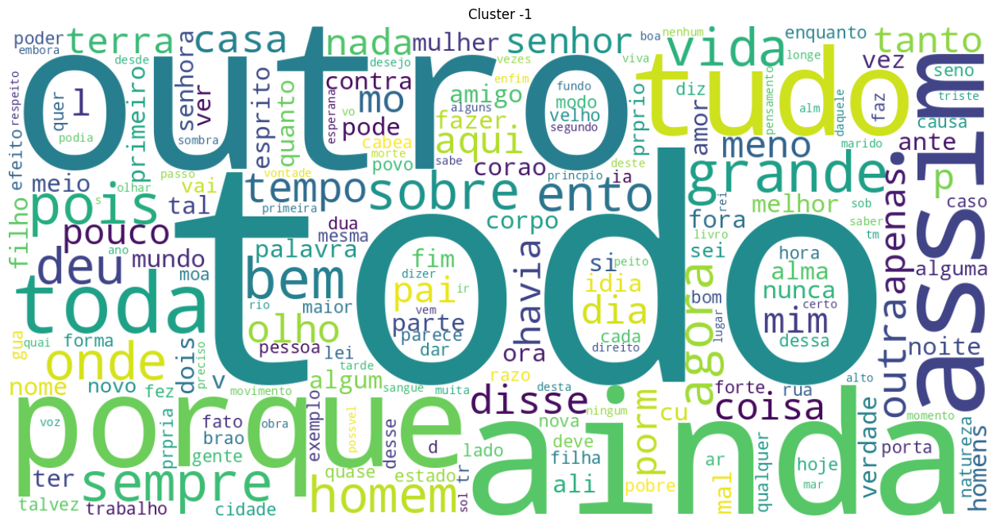

----- Cluster 999999 -----
Houve um erro ao construir o gráfico
----- Cluster 30 -----
Ide logo, por obséquio.
Este tomou a denominação de—"Protetor da vila em nome de Sua Majestade, e do povo".—Expediram- se logo várias ordens importantes, comunicações oficiais do novo governo, uma exposição minuciosa ao vice-rei, com muitos protestos de obediência às ordens de Sua Majestade; finalmente uma proclamação ao povo, curta, mas enérgica: "Itaguaienses!
Neste momento a S. Joaneira entrou, e logo da porta, abrindo os braços: - Viva!
Todos concordaram logo.
E Palma Cavalão, agitado com o tinir do ouro, desabotoou logo o jaquetão, sacou uma carteira onde reluzia um pesado monograma de prata sob uma enorme coroa de visconde.
Logo depois voltou, atirando ao ar as grandes patas, saltando alegre.
E logo depois tomando-me pelo braço, e obrigando-me a deixar o banco, acrescentou: —Retire-se; recolha-se à casa; diga a seus parentes que cuidem mais e melhor do senhor.
Creu um instante que o opulento se

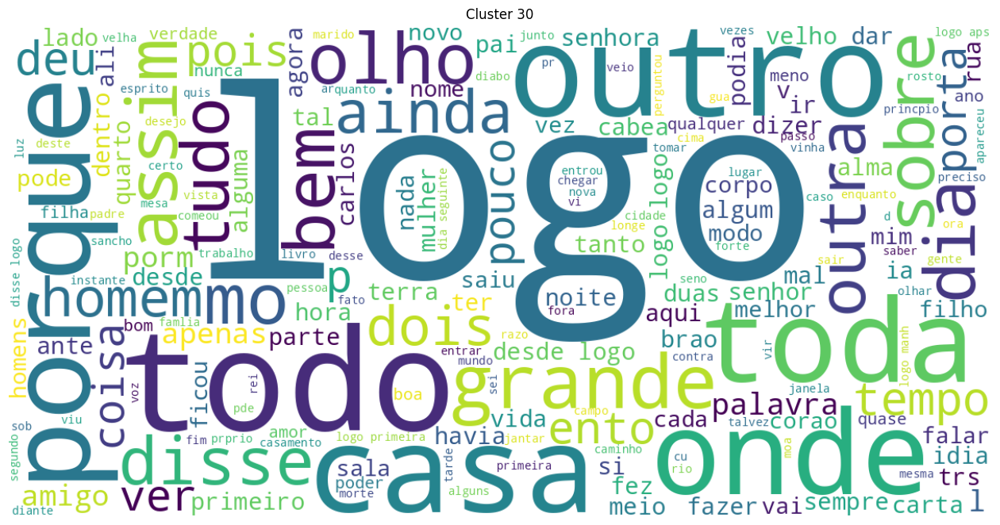

----- Cluster 458 -----
Também podia acontecer que entrasse aí algum plano de casamento.
Pois casarás com ele.
Aqui chorando o exora a bela esposa, Da cativa cidade os males pinta, Arquejando os varões, em cinza as casas, Presas virgens de rojo e as mães e os filhos.
Desci ao andar térreo da casa, apressando-me agora para aproveitar a mesquinha luz da vela que, pouco a pouco, me abandonava também.
— A uma distância enorme acima da minha sala subterrânea, casas se enraízam, brumas se reúnem.
Havemos de destruí-los; leia a Atalaia, meu bom companheiro de lutas; recebê-la-á em casa... — Não, senhor.
Só há um recurso, fugir, casar fora daqui, ver-me livre dele.
CORREGEDOR Domine, memento mei!
Se os habitantes de Sodoma quiseram cometer o pecado da pederastia com os anjos que foram à casa de Ló?
- E você, foi àquela rua, àquela casa?
Não se devem fazer visitas a desafetos; o menos que acontece é não achá-los em casa.
Carlos saía pouco de casa.
O domínio espanhol durara treze anos: data dele

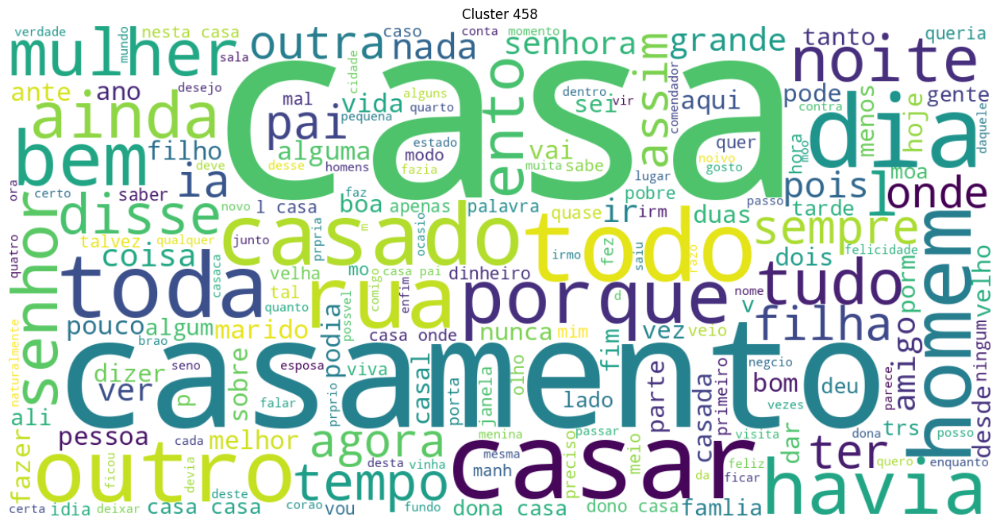

----- Cluster 283 -----
– Não, não ouso... disse resolutamente Camilo.
Criaram relações variadas, modestas como eles e de boa camaradagem.
O caminho não era freqüentado, como que se tornava mais difícil e em parte quase intransitável.
Tem quarenta praças o destacamento que Quaresma comanda, três alferes, dous tenentes; mas os oficiais pouco aparecem.
Tornaram pelo mesmo caminho e, atravessando a sala de jantar e o corredor, subiram por uma larga escada iluminada por uma clarabóia, alcançando o pavimento superior.
O sujeito olhou para Camilo, estacou, recuou um passo, e depois de uma razoável hesitação, exclamou: – Não me engano!
No entanto, Marta, não podendo já consigo, entalada de riso, fugira da varanda e atirara-se de bruços sobre a cama, a rebolar-se, a espernear como se tivesse uma cólica.
Bom Camilo, salvador de meu pai e agora nosso, médico de nós todos: que faremos?
Por isso as esqueçamos Como se não houvessem.
O camarote próximo estava vazio; perdi quase todo o es- petáculo a

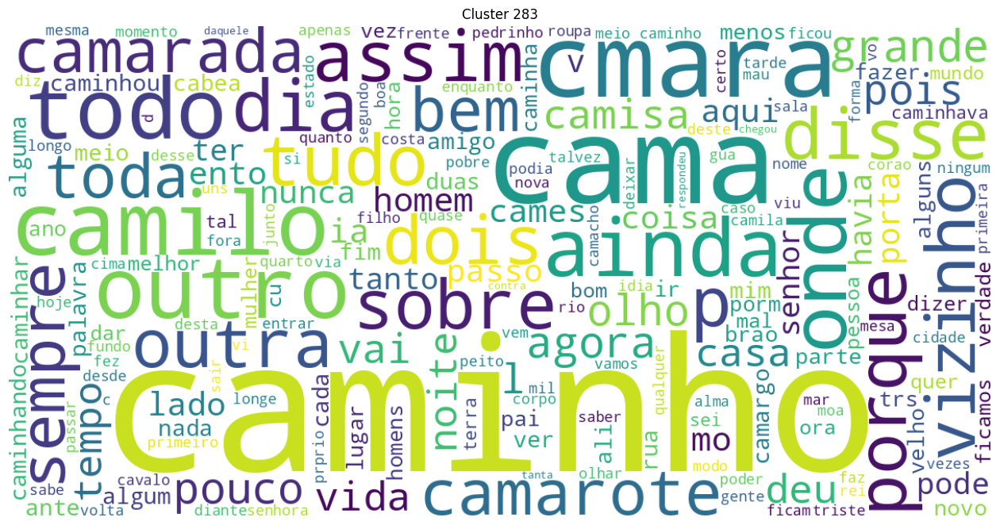

----- Cluster 481 -----
O Lamartine É monótono e belo como a noite, Como a lua no mar e o som das ondas... Mas pranteia uma eterna monodia, Tem na lira do gênio uma só corda, Fibra de amor e Deus que um sopro agita: Se desmaia de amor a Deus se volta, Se pranteia por Deus de amor suspira.
Faz calar o teu amor-próprio, e emprega a tua vaidade em bloquear com ternuras calculadas uma inocente a quem possas fazer feliz, enquanto a enganas…” - “Julgas, portanto, que te minto !…” - “Não julgo, não.
reza baixo... amor... Foste tu que o mataste!
A senhora tem o direito de lhe dar o amor e a saudade.
E amor inda é presença e motivo.
Outras mais prudentes, receando os resultados do amor, refugiam-se nas precauções da libertinagem... Sem contar as senhoras que, em vista dos pequenos ordenados, completam o marido com um sujeito suplementar!
dizia ele consigo; não quer que do nosso encontro resulte atear-se o amor que me prende a ela.
São as páginas despedaçadas de um livro não lido... E agora que 

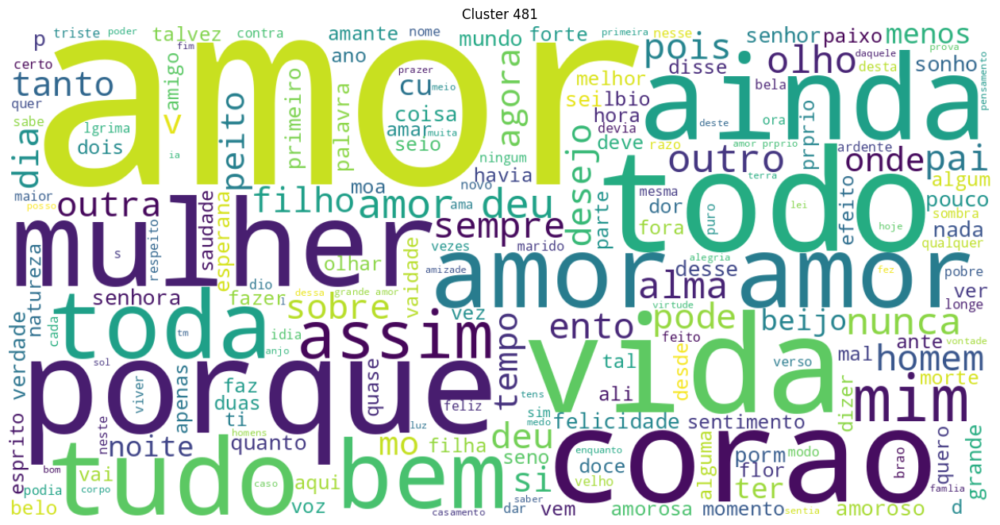

----- Cluster 277 -----
Ora, Sua Majestade imperial, tendo a máxima confiança na vossa 63 coragem, e tendo em altíssimo apreço a vossa força, pediu-me que vos pormenorizasse todos estes assuntos, a fim de saber quais as vossas disposições a respeito de semelhante assunto.
Quem vos isto diz, Senhora, serviu nas vossas armadas www.nead.unama.br 76 muito, mas anda já fora; e pode ser que inda agora traz abertas as frechadas.
Desde que se cortem todos aqueles empecilhos que eu apontei, no memorial que Vossa Excelência teve a bondade de ler; desde que se corrijam os erros de uma legislação defeituosa e inadaptável às condições do país, Vossa Excelência verá que tudo isto muda, que, em vez de tributários, ficaremos com a nossa independência feita...
Esposa minha, estimai o senhor de Hastings, deixai-o beijar vossa mão.
– Eu parece−me que estou muito contente, meu senhor... O Sr. Cruges também mora cá por cima... – Bem sei, bem sei... – Tenha Vossa Excelência a paciência de esperar um instant

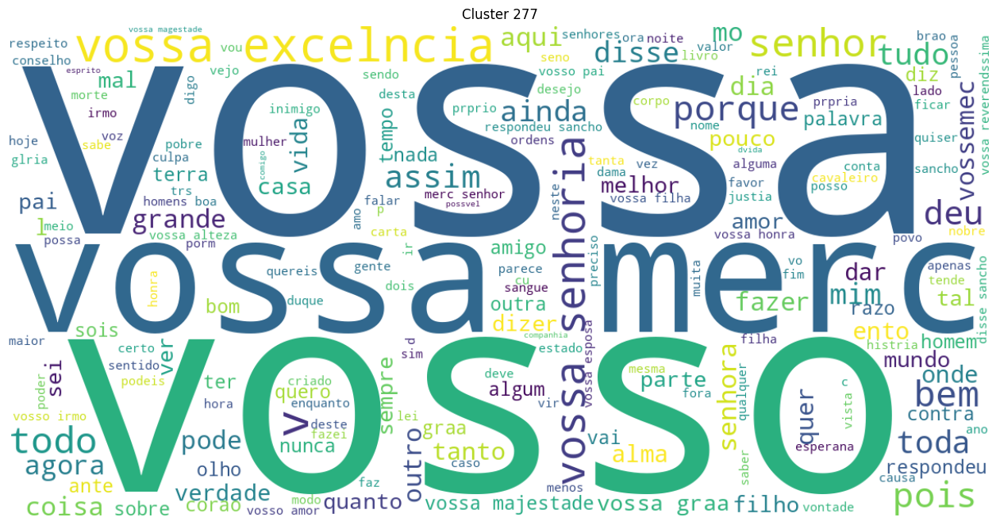

----- Cluster 630 -----
Se há nos homens diferença, esta só se acha nos (163) cetros, e coroas; os que dominam a terra, têm a semelhança dos humanos, mas não sei que têm de mais: têm o mesmo ser para serem homens, mas não para serem como os mais homens: quem os fêz maiores, foi a Providência; só esta podia influir di- versidade no que é o mesmo; podia fazer qeu uma identidade fôsse diferente de outra da mesma espécie ; e podia, debaixo da mesma forma, e dos mesmos acidentes, fazer uma natureza desigual.
O senhor não me parece um homem!...
Um homem, que me pareceu jornalista, pediu-me licença para levar o manuscrito e imprimi-lo.
Pensa que há um deus do bem e um deus do mal, em conflito travado sobre a vida do homem?
Em vez disso, inaugurei o meu sistema, fundado no princípio de que o homem deve dizer tudo o que pensa.
mas, se tivesse rigorosamente de escolher marido, escolheria um homem que me parecesse  bem vulgar.
Primeiramente diz que este senhor era um homem rico: Homo quidem erat 

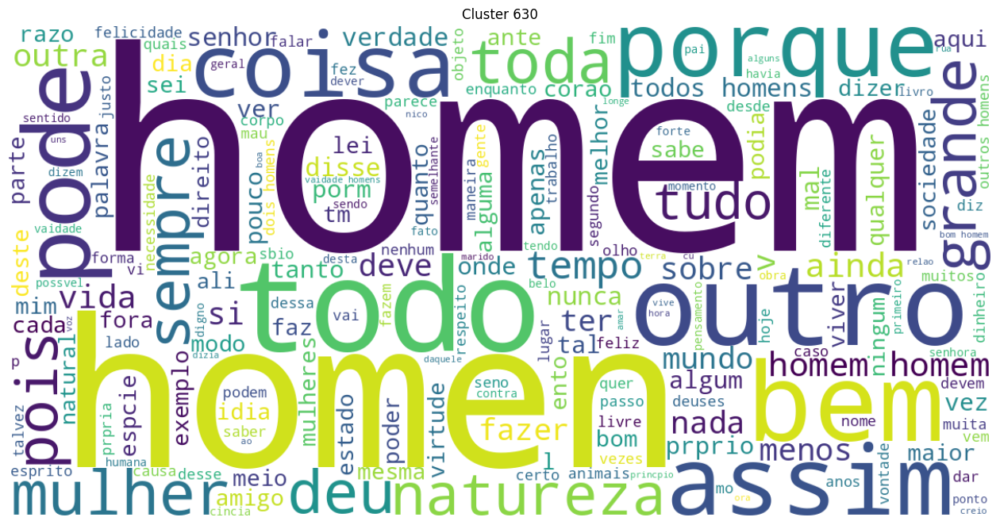

----- Cluster 419 -----
E a um lado e a outro o cimo meneando, Como se lingua fora, que falasse, 90 Estas vozes profere, e diz-nos: “Quando “De Circe a encantos me esquivei fugace, Em que um ano passei junto a Gaeta, 93 Antes que assim Enéias a chamasse, “A saudade do filho, a mui dileta Velhice de meu pai, de alta consorte 96 Santo amor, em que ardia sempre inquieta, “Não dominaram esse anelo forte Que me impulsava a ser do mundo esperto, 99 Das manhas das nações, da humana sorte.
178 Pele do pescoço, quando flácida e bamboleante.
40 COMÍNIO — Sim, caso não tragais sangue inimigo como manto, mas próprio.
“Conhece agora que mistério esteja Na Graça — aquilo, que inda o mundo ignora — 72 Bem que o fundo inefável não lhe veja.” — Qual codorniz que os vôos seu demora, Paira cantando e cala-se, enlevada 75 Nas doçuras finais da voz sonora: Tal parece-me a imagem sinalada Pelo eterno prazer, que, a seu desejo, 78 Faz que seja quanto é cousa criada.
“Em duvidar, por certo, iria avante 669 Qu

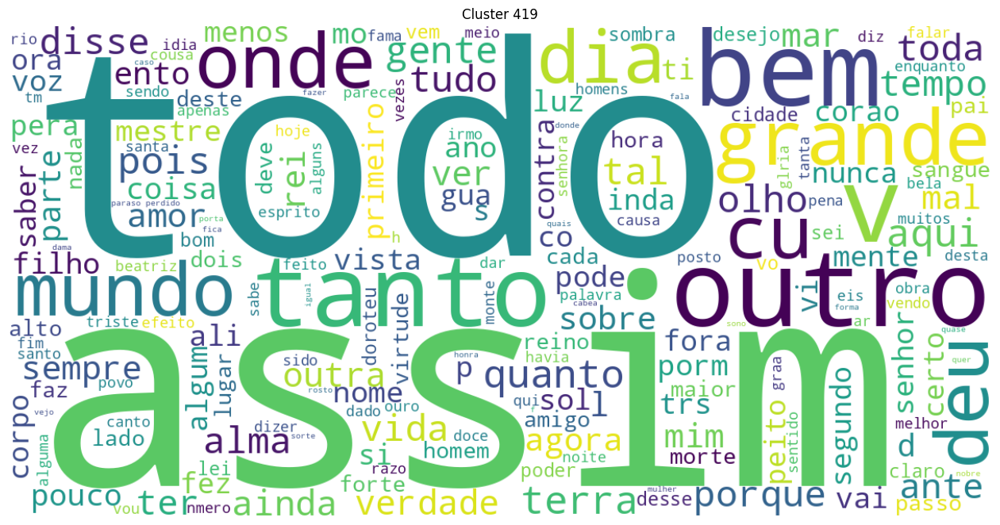

----- Cluster 355 -----
A morte de Tomás Coelho, em qualquer circunstancia, seria dolorosa; mas o repentino dela tornou o golpe maior.
— É aquele homem que nos salvou o Deolindo da morte.
Até os mortos trabalham a teu favor.
Mas agora, depois de todas aquelas reformas de vida; depois da separação das camas, e principalmente depois que corresse a noticia do casamento, não faltaria decerto quem o acusasse, se a negra aparecesse morta de repente!
Só eles, e isto raramente, são consultados pelo rei; formam um conselho de guerra, que julga os delitos e só aplica duas espécies de penas: a mutilação e a morte.
Mal entravam na cidade, chorando a morte do benfeitor, quando sentem o solo tremer sob os seus pés; o mar, furioso, galga o porto e despedaça os navios que ali me acham ancorados.
E aqui mesmo, já apanhei uma indigestão em casa de uns minas no dia da morte de um deles.
Ao seu aspecto, ninguém à primeira vista adivinharia que um germe de morte lhe ia solapando a existência.
Como as flore

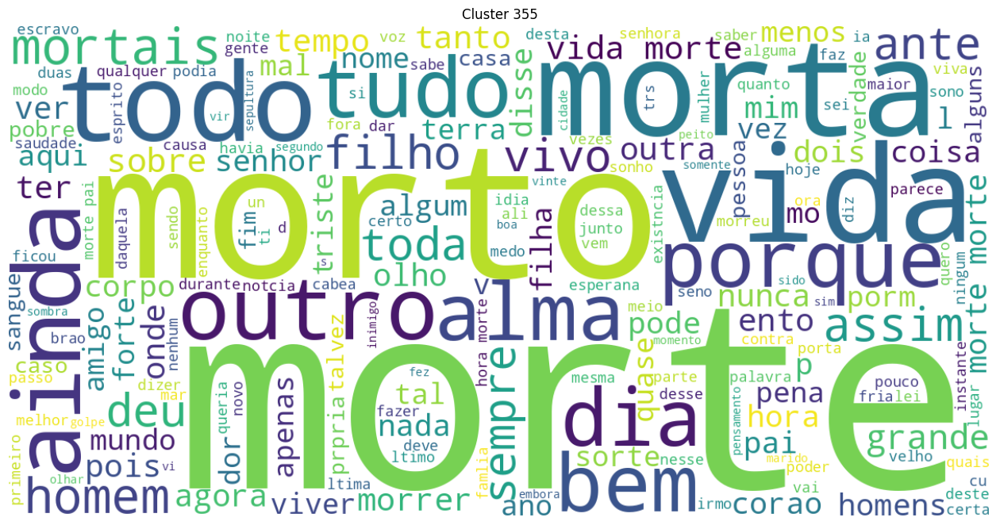

----- Cluster 601 -----
Se o pensador e o jurista em Tobias Barreto iam à cultura germânica, tratada embora por ele mais lírica que objetivamente, o seu temperamento estético, em música e em poesia, revê demais o mestiço luso-africano.
E qualquer um aceitaria obter tais filhos mais que os humanos, de-pois de considerar Homero e Hesíodo, e admirando com inveja os demais bons poetas, pelo tipo de descendentes que deixam de si, e que uma imortal glória e mem6ria lhes garantem, sendo eles mesmos o que são; ou se preferes, continuou ela, pelos filhos que Licurgo deixou na Lacedemônia, salvadores da Lacedemônia e por assim dizer da Grécia.
As telas (teias) d’ ouro fino: v. Égloga III de Garcilaso, possível fonte do Poeta (vv.
18.5 “Mas a linda Ericina, que guardando”: no poema é Ericina quem vai salvar as naus.
Nenhuma mãe contemplou o filho recém nascido com mais amor do que o rapaz leu e releu a produção poética, aliás decorada desde a véspera.
Publicando-o, precedeu-o o autor de um prefác

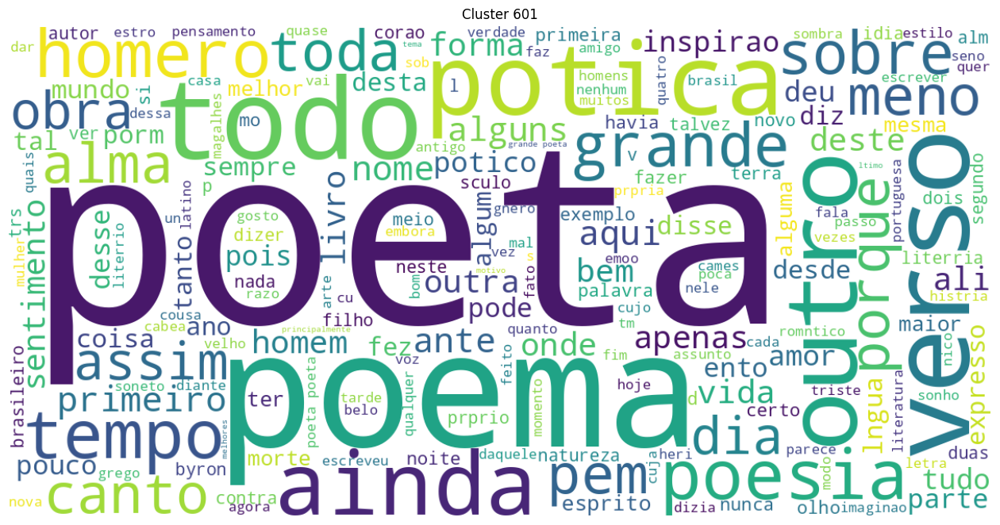

----- Cluster 1 -----
1894 Car tas à Ga ze ta de No tí ci as con tra um se na dor, em de fe sa de pre sos po lí ti cos, cri an do em ba ra ços para Flo ri a no, que o man dou para Cam pa nha, Mi nas Ge ra is.
É che ga do o mo men to de co me çar a pa gar a dí vi da ex ter na.
251 Da dos so bre o au tor da Capa pág.
To das es tas ca u sas jus ti fi cam o pâ ni co in des cri tí vel que la vra atu al men te no ser tão e o re flu ir de sor de na do de po pu la ções in te i ras para os mais re mo tos pon tos.
XL Eu cli des da Cunha 69 Jor nal do Se na do.
Assim é que, er gui da ra pi da men te a pri me i ra vi ven da do bar - ra cão, sem pre à be i ra do rio prin ci pal, na bar ran ca de uma ter ra fir me a ca - va le i ro das águas – e fe i to um re co nhe ci men to pre li mi nar do la ti fún dio que o ro de ia, o si ti an te pro cu ra um ser ta nis ta ex pe ri men ta do a quem con fia o en car go de di vi dir- lhe e ava li ar-lhe a fa zen da.
O nos so oti mis mo im pe ni ten te, po rém, q

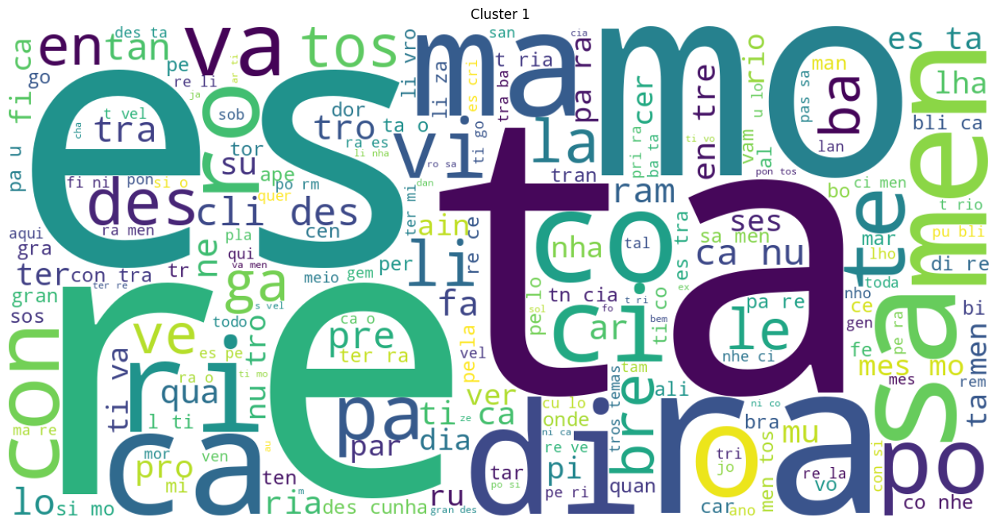

----- Cluster 422 -----
Tibério mostrou-se satisfeito com esta visita do filho.
Pahã, a seta, era o último filho de Canicrã.
Meu lar está deserto... Um velho cão de guarda Veio saltando a custo roçar-me a testa parda Lamber-me após os dedos, porém a sós consigo Rusgando com o direito, que tem um velho amigo... Como tudo mudou-se!...
As amas, apesar de os distinguirem entre si, não deixavam de querer mal uma à outra, pelo motivo da semelhança dos "seus filhos de criação".
— Tudo velho, Sra.
Ainda ali ajoelhou-se, mas em vão.
Alcméon era filho de Erífila.
O velho pajé que velou toda a noite, falando às estrelas, conjurando os maus espíritos das trevas, entra furtivamente na cabana.
O velho debulhou uma risadinha que lhe era peculiar.
— É seu pai, mas não é o meu, embora eu o respeite mais do que um filho.
O que ele queria era o velho direito de abrir ou fechar a porta das masmorras!
(52) – Os Silenos de Alcebíades eram velhos Sátiros.
Por sua vez, o mais velho se torna mais moço do que o

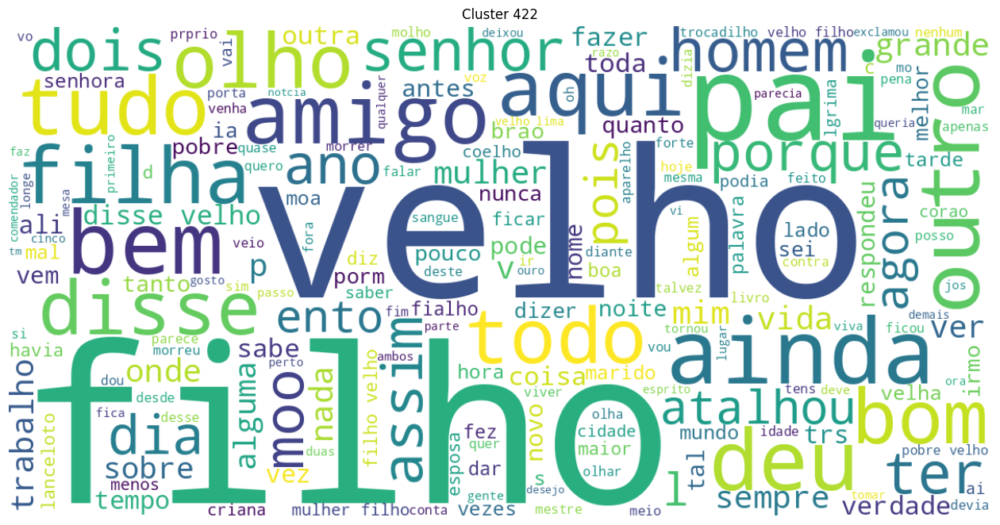

----- Cluster 639 -----
Em terceiro lugar (c), para fins de refutação, veja-se se um atributo descrito em termos de um estado (x) não é uma propriedade do estado proposto (Y): pois, nesse caso, tampouco o atributo descrito em termos da privação de X será uma propriedade da privação de Y. E também se, por outro lado, um atributo descrito em termos da privação de X não é uma propriedade da privação dada de Y, tampouco o atributo descrito em termos do estado X será uma propriedade do estado Y. Assim, por exemplo, como não se predica como uma propriedade da "surdez" o ser uma "ausência de sensação", tampouco poderá ser uma propriedade da “audição” o ser uma "sensação".
Sofia, para emendá-lo, vexava-o com censuras e conselhos, rindo: — “Você esteve hoje insuportável; parecia um criado.” — “Cristiano, fique mais senhor ele si, quando tivermos gente de fora, não se ponha com os olhos fora da cara, saltando de um lado para outro, assim com ar de criança que recebe doce...” Ele negava, explicav

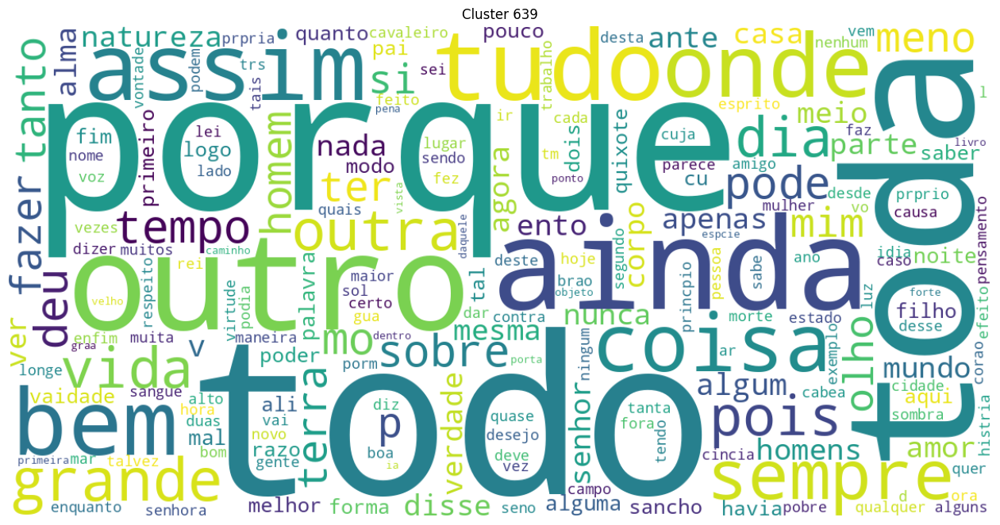

----- Cluster 139 -----
Os Maias Capítulo VII 113 O desgraçado equilibrava−se sobre a perna roliça ; o florete de Craft vibrou, rebrilhou, voou sobre ele ; Dâmaso recuou, sufocado, cambaleando e com o braço frouxo... – Firme !
CAPÍTULO LXVI Que trata do que verá quem o ler, ou do que ouvirá quem o ouvir ler.
CAPÍTULO 72 O bibliômano Talvez suprima o capítulo anterior; entre outros motivos, há aí, nas últimas linhas, uma frase muito parecida com despropósito, e eu não quero dar pasto à crítica do futuro.
Querer dizer-nos que não finge, E a palavra embrulhar-se na laringe, Escapando-se apenas em latidos!
CAPÍTULO III DOS PRINCIPADOS MISTOS (DE PRINCIPATIBUS MIXTIS) Mas é nos principados novos que residem as dificuldades.
CAPÍTULO LVIII DIAS antes, indo passar a noite em casa de um conselheiro, viu ali Rubião.
Eu vou, vou já, de um capoeira As aparências tomar!
CAPÍTULO III - DEUS SABE O QUE FAZ Ilustre dama, no fim de dois meses, achou-se a mais desgraçada das mulheres: caiu em profunda 

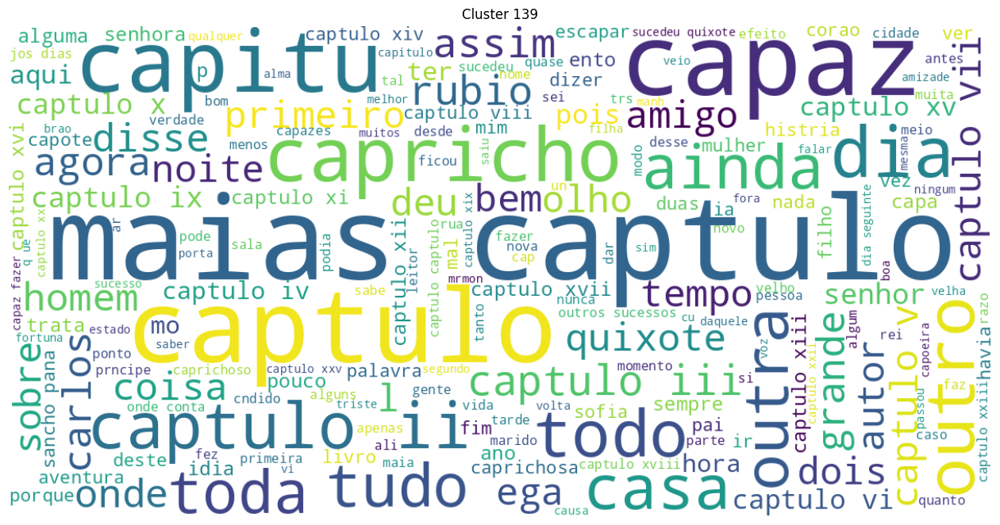

----- Cluster 447 -----
Seu primeiro movimento foi voltar o rosto; mas reprimiu-se a tempo, e disfarçou dirigindo o binóculo para o fundo da sala.
A segunda razão é que o próprio Tristão está com vontade de acompanhar o desembargador e Fidélia; nunca viu uma fazenda, e tem vontade, antes de voltar para Lisboa... — E a nossa amiga, diante desse eclipse dos dous, não está aborrecida?
Depois, ao acalmar o calor, propôs que fossem comer as sopas à Toca, Ega deu uma volta pelo quarto, hesitando.
UNIÃO DOS ARCOS Os tapuias voltaram; com eles vinha Agniná à frente de sua nação, para vingar a morte de Canicrã, seu irmão.
(Volta Marco Antônio.)
XI – Comadre Flor voltara a embalar-se na rede, e Justa fazia outra vez corrupiar o fuso às castanholas de seus dedos ágeis.
Tentou entretanto voltar, porque não se queria meter em festa alheia, quando, levantando um dos jogadores a cabeça, conheceu nele um seu antigo camarada, o menino que fora sacristão da Sé.
(Volta o criado com o carcereiro.)
Este ve

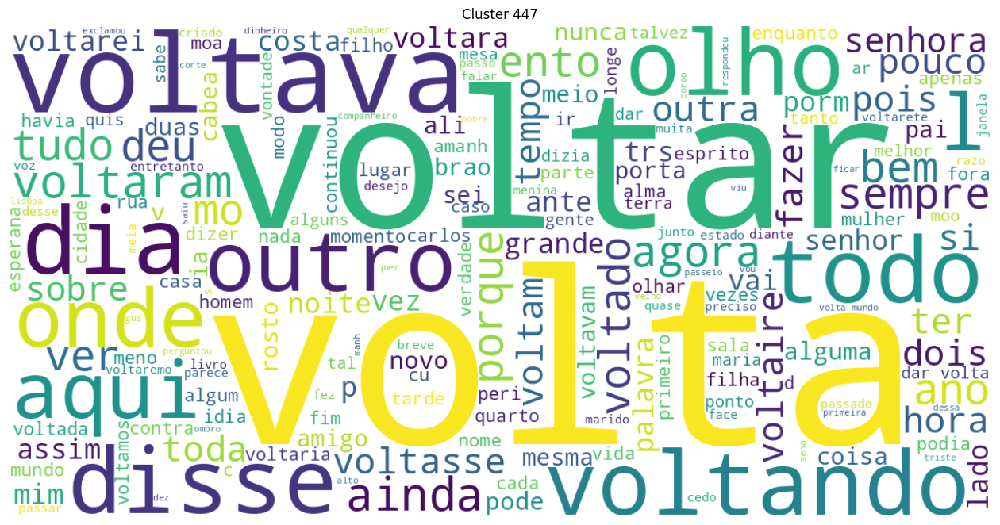

----- Cluster 272 -----
Se em meu proveito faz qualquer partido, só; na vista duns olhos tão serenos, que quero eu mais ganhar que ser perdido?
Tão certo como eu ter paz no sepulcro, o coração de pai lhe tiro agora.
E do sótão ignorado caíam, chuva de rosas sobre as fileiras, olhares de simpatia tão bons, tão expansivos que fariam esquecer o serra-fila ao galucho basbaque que os colhesse no ar.
o lugar e a ocasião são os menos próprios para revelações tão delicadas!...
Aonde estava A França tão potente e tão temida?...
Têm eles a vista tão pronta e a mão tão certa que os europeus nem se aproximam.
Zombarmos com tão nobre sociedade, era audácia de mais.
É tão estranho estar a viver.
A noiva tão procurada só por mim vos será dada.
Assim calada, tão negra, Torre de Santa Irenéia!
E depois a Dalmácia era tão longe!
Tenho estado tão triste!
Mas se reconhecia agora — que o não amava, ou tão pouco!
É tão bom ser feliz!
quando se encontra um par tão ajustado, como se dá conosco.


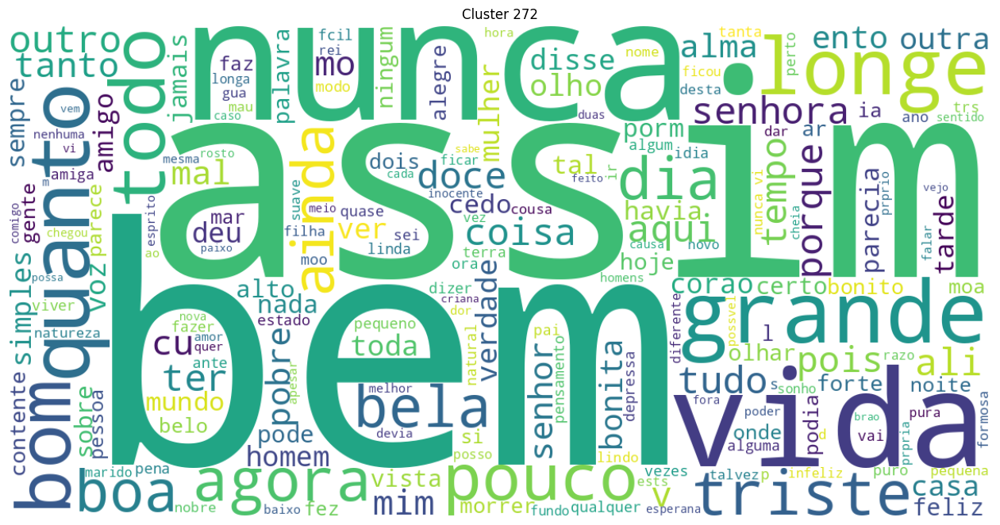

----- Cluster 618 -----
– gritou Carlos, apertando as mãos.
E escondeu a cabeça entre as mãos, a soluçar. Quando levantou, viu defronte de si Eugênia.
Mais tarde, se alguma jóia lhe levou os olhos, não lhe levou as mãos.
Ocultou o rosto nas mãos e desfez-se em pranto.
Depois, pesado e risonho, veio apertar a mão às senhoras que mergulhavam nos veludos e sedas, em mesuras de Corte.
(Tomando-lhe as mãos.)
Era pouco; lancei mão de um recurso último; entrei a sacar sobre a herança de meu pai, a assinar obrigações, que devia resgatar um dia com usura.
Inconscientemente, automaticamente, atraída, puxada pelos nervos, Lenita pôs as mãos no colchão fofo, curvou-se, aproximou a cabeça.
Em pé, diante de uma janela, com o cotovelo esquerdo apoiado na mão direita, aberta, e o queixo na mão esquerda, fechada, perguntou ele a si: — Mas deveras estariam ele doidos, e foram curados por mim, — ou o que pareceu cura, não foi mais do que a descoberta do perfeito desequilíbrio do cérebro?
Todos se erguera

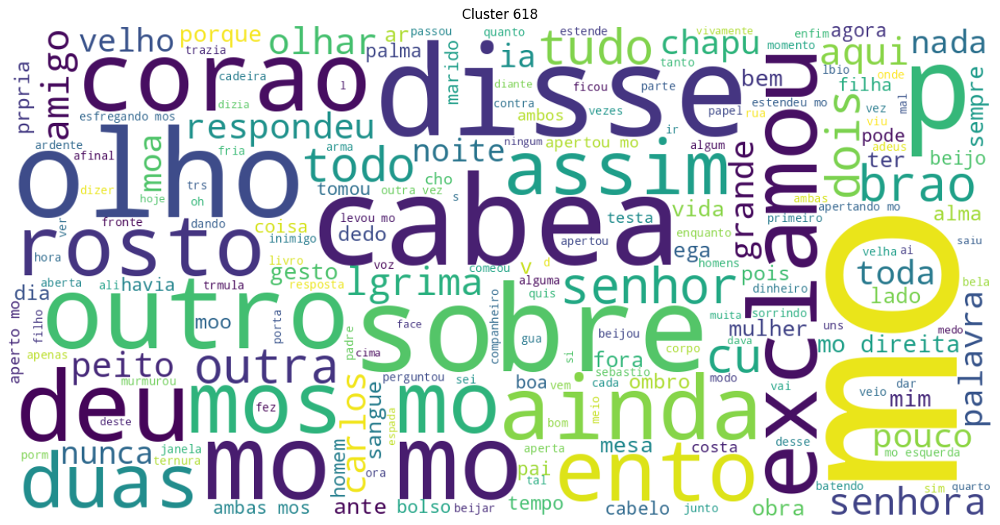

----- Cluster 536 -----
Espera, que eu vou.
Eu sou a Indiferença.
Eu, se fosse padre, havia de pregar também.
- Quem sou eu?
- Eu, não.
E fui eu que o matei!
Falai-me, para meu governo, embora eu jure que conheço a voz.
A raiva com que estava a mim própria era tal que nem lugar me deu para lhe eu querer mal.
- Que eu não a conheço, disse a excelente senhora.
Ele quer, eu quero.
Eu sei lá bem Quem sou?!
Falai-me, gritai-me, para que eu acorde, para que eu saiba que estou aqui ante vós e que há coisas que são apenas sonhos.
Por que falo eu sem querer falar?
— E eu, Andrew Speedy, da Cardiff.
Isso te afianço eu!


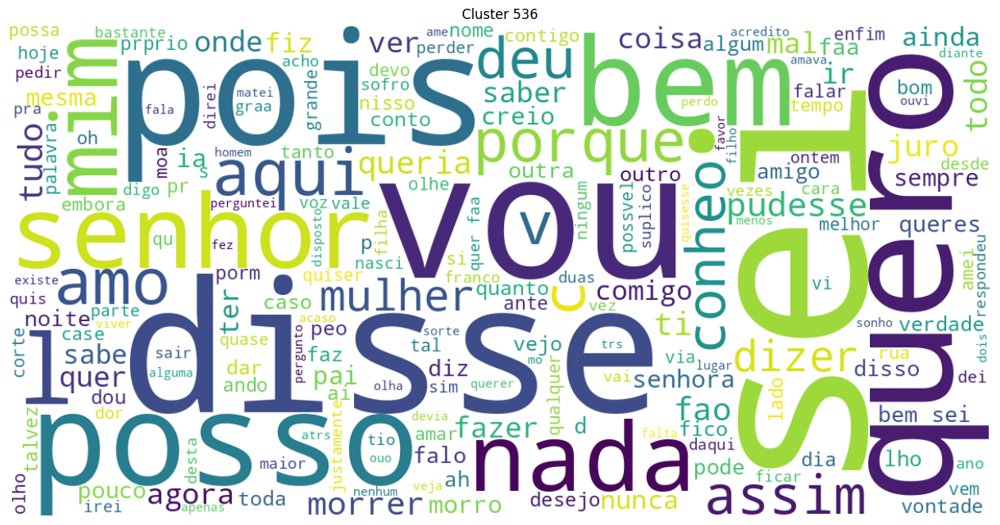

----- Cluster 583 -----
Levarás amanhã, uma carta minha a um dos ministros.
Fica com esta lembrança da minha parte e dize- lhe uma palavrinha a meu favor.
esse afã foi a minha obsessão: devora-me.
E eu com o seu dinheiro fiz a minha posição de menos pobre.
Estou com vontade que conheças minha irmã!...
Mas, confiado em minha perspicácia, vou tentar a aventura.
—Pela minha gratidão acho-o ótimo.
— Que é isto, minha mãe?
Deus a abençoe, minha menina, Deus a abençoe!
— Não posso dar explicações, minha senhora!
Levai-lhe minha cabeça.
Conheço-me por culpada, e digo diante vós minha culpa.
Sabes a minha morada.
— Mas então só me resta o recurso de fingir, indiferença, e amá­la em segredo, amá­la com todo o  ardor da minha paixão!
Ninguém, minhas fi- lhas!


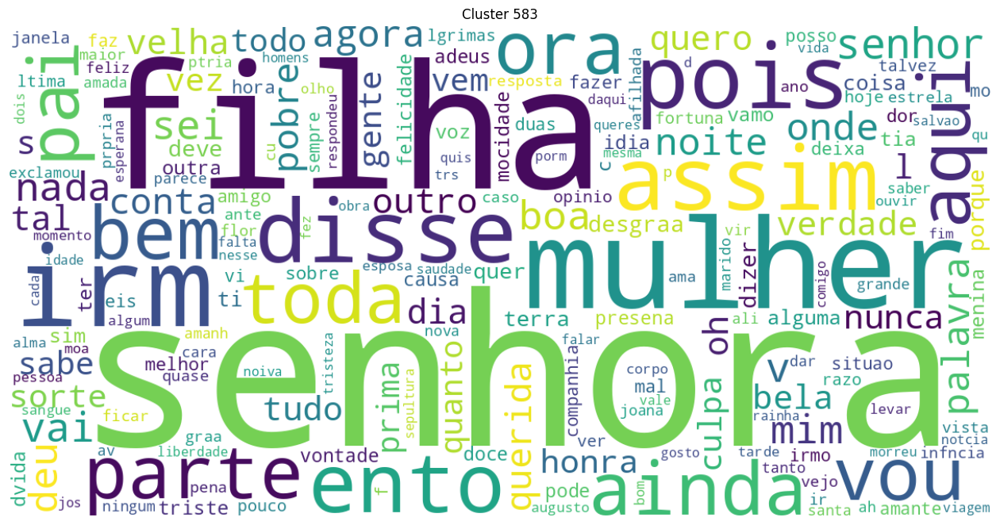

----- Cluster 171 -----
Quinhentos mil-réis de multa!
Fechei um olho, calculando: -Eu te digo... Cada queijo, um desses queijinhos redondos, como o Camembert ou o Rabaçal, pode vir a custar-te, a ti Jacinto queijeiro, entre duzentos e cinqüenta e trezentos mil-réis.
Catava-se um rei, quando acha nas suas meias reaes uma grande pulga macha, pai-avô e Adão das mais, O RÃS Vocês não ouvem?
O REI — Fez-vos grandes encômios, elogiando-vos de tal maneira na arte e no manejo das armas, sobretudo do florete, que proclamavam digno de ser visto, se alguém vos desafiasse.
Ao que parece, este serviço estava a cargo de Fuão Silva, que o fazia de graça, e foi dado a outro por 400$000 mensais.
Se o Rei de Macedônia, ou qualquer outro, fizer o que faz o ladrão e o pirata, o ladrão, o pirata e o rei, todos têm o mesmo lugar, e merecem o mesmo nome.
O REI — De fato, não devia haver santuário que o homicida amparasse, nem limites para a vingança.
— A senhora ou me dá seiscentos mil réis, ou eu não largo 

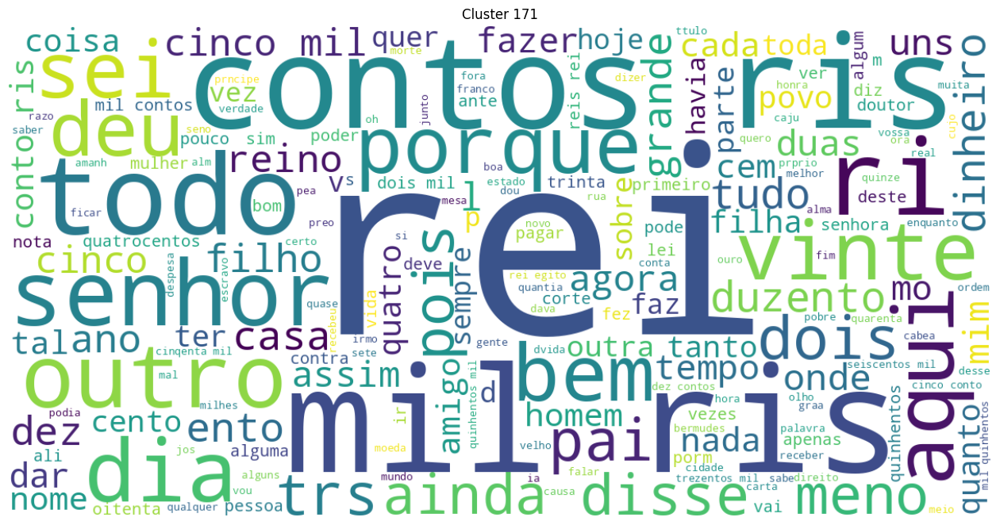

----- Cluster 10 -----
Sócrates – O segundo bem é a proporção, o belo, o perfeito, o suficiente e tudo o que faz parte da mesma família.
LX — Sócrates — Com isso em mira é que o orador honesto e competente deverá dirigir seus discursos à alma dos homens, sempre que lhes falar, e todos os seus atos; e quer lhes dê ou tire alguma coisa, deverá pensar e sempre no modo de fazer nascer a justiça na alma de seus concidadãos e de banir a injustiça, de implantar nela a temperança e de afastar a intemperança.
Polo — Para os médicos, Sócrates.
Sócrates — Ótimo!
Neste momento, nos disse, os Onze estão tirando os ferros de Sócrates e lhe comunicam que hoje ele terá de morrer.
Teeteto — Então, de que maneira conversarás, Sócrates, se te proibires empregá-los?
(49) – São máximas de Sócrates: É melhor sofrer uma injúria do que fazê-la; a morte não é um mal; a filosofia consiste em meditar na morte, etc.
Forçosamente, Sócrates, falou Cebete, sempre permanecerá a mesma e do mesmo jeito.
XXXVII — Cálicl

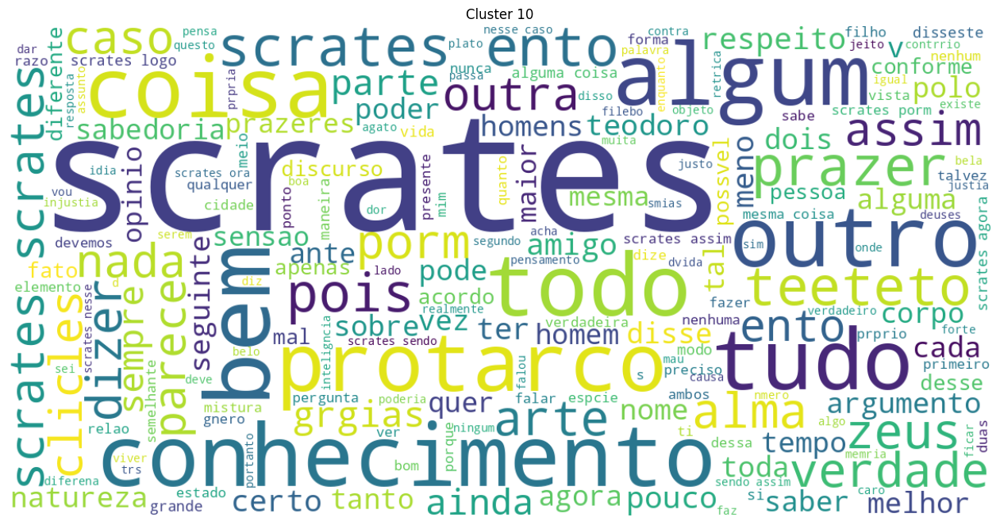

----- Cluster 513 -----
Breve estarão na minha frente como erva seca, como uma estepe, e verdadeiramente fatigados de si mesmos, e mais sedentos de fogo que de água!
Às linhas te recolhas; Evita o meu furor, foge, que é tempo.
Passando a maldita casa, Jorge, que assim se chamava o moço, disse-me com fogo: - Aquela jovem adora-me!
morrerei como a flor que da sombra orvalhada do bosque foi transplantada para os areais de fogo.
Sei, ao contrário, que o senhor me adora; me adora  com fogo, com entusiasmo, com paixão, com poesia!
Como cega barboleta ao fogo da minha fé se queima a desconfiança de nunca te merecer.
Tens o seio de fogo e a alma fria.
E quando alguém atravesse o fogo pela sua doutrina, isso que prova?
Durante que volviam em torno dos fogos da alegria, ressoavam as canções.
Não sei se me explico bem, nem é preciso dizer melhor para o fogo a que lançarei um dia estas folhas de solitário.
Quando foram todos sentados em torno do grande fogo, o ministro de Tupã ordena o silêncio co

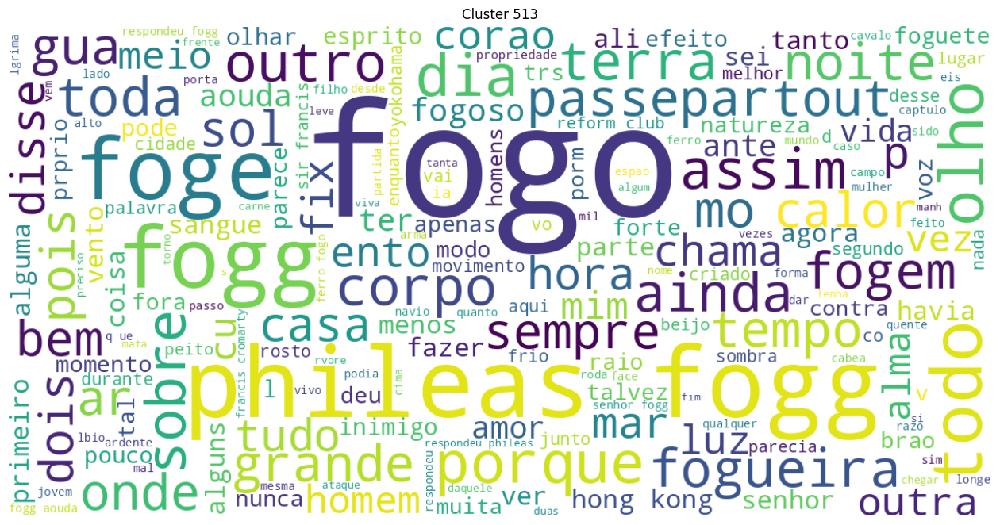

----- Cluster 563 -----
Ademais, não se presta atenção à natureza do sujeito e do predicado.
Perpassei pelo vulto humano e, lá ao longe, descavalguei, prendi as rédeas e retrocedi sutilmente a es- preitar o escândalo, se escândalo era.
— Porque assim é preciso, amigo.
Contudo, quis-me parecer que ele o rosto levantava, pondo-se em movimento, como prestes a falar.
Tu o que precisavas era de um cáustico na nuca!
Isso, querido, é trabalhar às claras, e eu preciso resguardar-me na sombra.
PREBOSTE — Irei depressa.
Há os que gostam de ser prejudicados.
Não: era preciso fazer qualquer coisa!
Bem sabes que era preciso fazer o que se fez.
É preciso o ocultar, ocultar.
Esméria encontrou Pai-Raiol no fundo do quintal e onde velhas laranjeiras desprezadas pela incúria secavam no meio de moitas de arbustos e cobertas de ervas parasitas.
Se fizésseis da amizade um preceito, um mistério, um rito, uma cerimônia, milhares de bonzos, pregando e escrevendo suas tolices, cobririam esse 119 sentimento de 

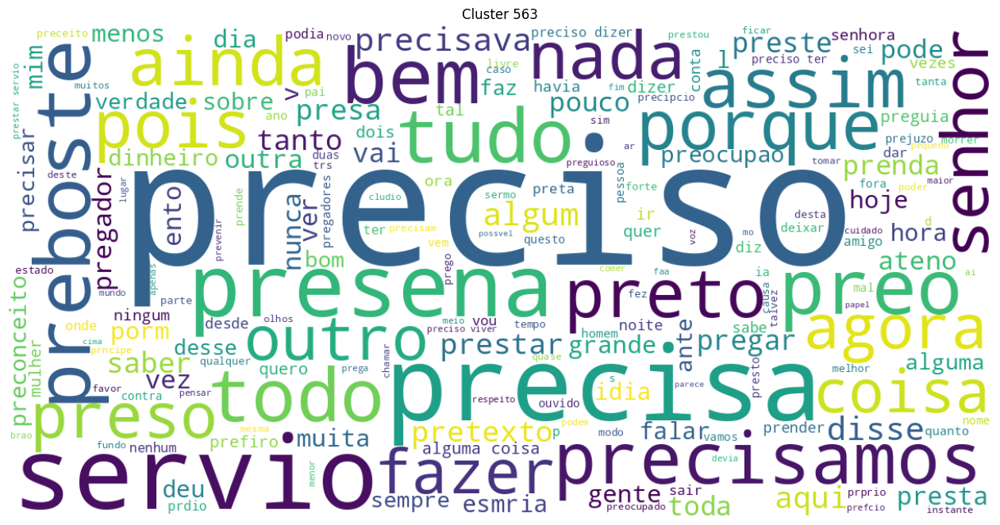

----- Cluster 484 -----
Então solta-se ou não a pequena?
Parece-te então que era muito do tom Ir com ele, num mês, a dois bailes?
Bateram então à campainha.
— Então... — Coragem!
- Mas então?...
– Então, senhora condessa, ainda muito comovida com a eloquência do Rufino ?
Todos então o aclamam e convidam a entrar e a recostar-se, e Agatão o chama.
No meu tempo... GASTÃO Ah!
- Que fazer então?
– Então abrimo−la ?
— Então, coisa-ruim!
- Então aceito a objeção.
- Por que então?
Quem és, então?
— Então adeus, meu caramanchão, minha fonte, meu jardim, adeus!


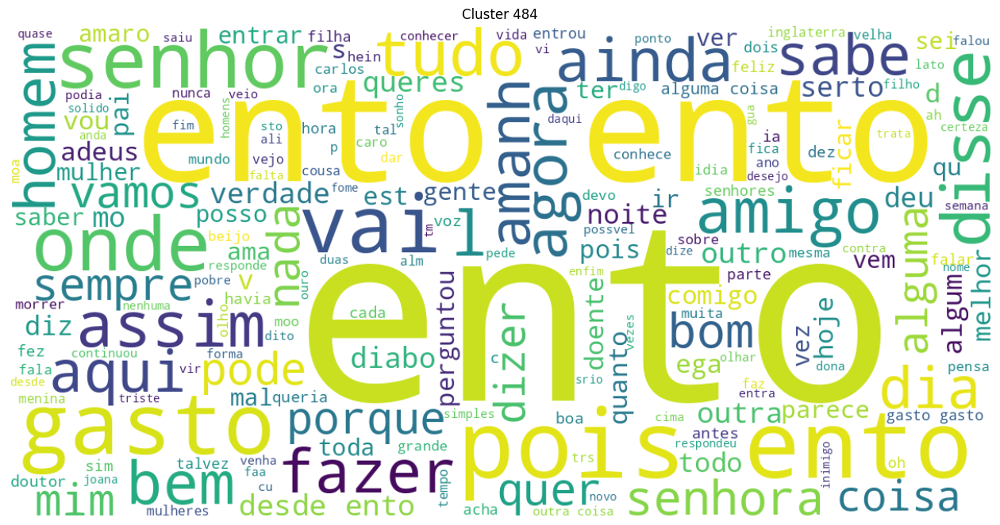

----- Cluster 615 -----
Por fim, o Silva levantou a cabeça e ternamente indagou: — Quem é a madrinha?
Baixou os olhos, de repente, erguendo a cabeça, exclamou: Mas espere, há um que tem onze, tira-se-lhe uma e passa-se para este e fica tudo arranjado.
Os cabelos eriçaram-se sobre a fronte do italiano; gotas de suor frio e gelado sulcaram as suas faces pálidas e contraídas.
Que pensas com a cabeça.
O fidalgo abanou a cabeça em sinal de dúvida.
Sancho, que a tudo estava presente, disse abanando a cabeça: — Ai, senhor, senhor!
Os caboclos, de boca aberta, o escutavam como olhos e ouvidos transidos de pavor, e de vez em quando, estremecendo, olhavam em derredor pela mata, como que receando ver surgir o temível esqueleto a empolgar e levar pelos ares alguns deles.
Os cabelos cortados rente, deixavam-lhe descoberta a nuca, móvel e branca como um pescoço de cisne.
Também não quero que tenha O cabelo assaz comprido, Que em matos de tiririca Achar-me-ia perdido.
Dez carapicus saíram em frente; 

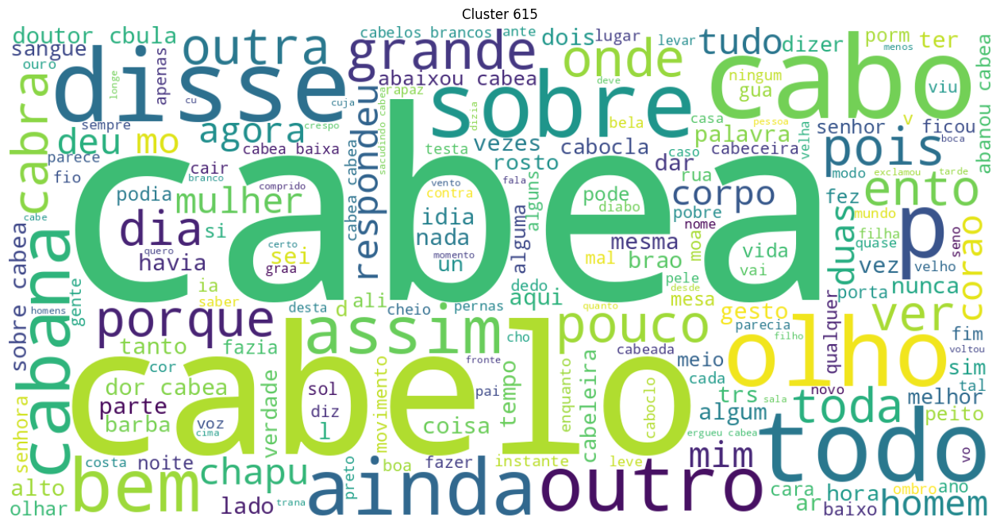

----- Cluster 490 -----
— Foi ele deveras?
— Foi o que lhe aconteceu hoje.
“ — Este foi de sentimento!...
61.4-8 “Onde já foi Parténope enterrada”: Parténope foi uma das sereias que, quando Ulisses se lhes escapou, se lançaram ao mar; o seu corpo deu à costa no local onde, mais tarde, foi construída a cidade de Nápoles.
Não, não foi isso.
Foi um avançar em desordem.
Foi isto em 1855.
De que foi?
Foi até à janela.
Que foi isso?
Esta a consolação última e doce Da esposa indiana foi.
Alem disso, tal propriedade fundiária foi transformada em pastagens.
Salvar o passado no homem e transformar tudo “o que foi” até a vontade de dizer: “Mas eu queria que fosse assim!
A mar cha da ca noa não foi uni for me.
Quando foi apresentado este assunto ao conselho, a parte mais sensata apoiou o meu parecer.


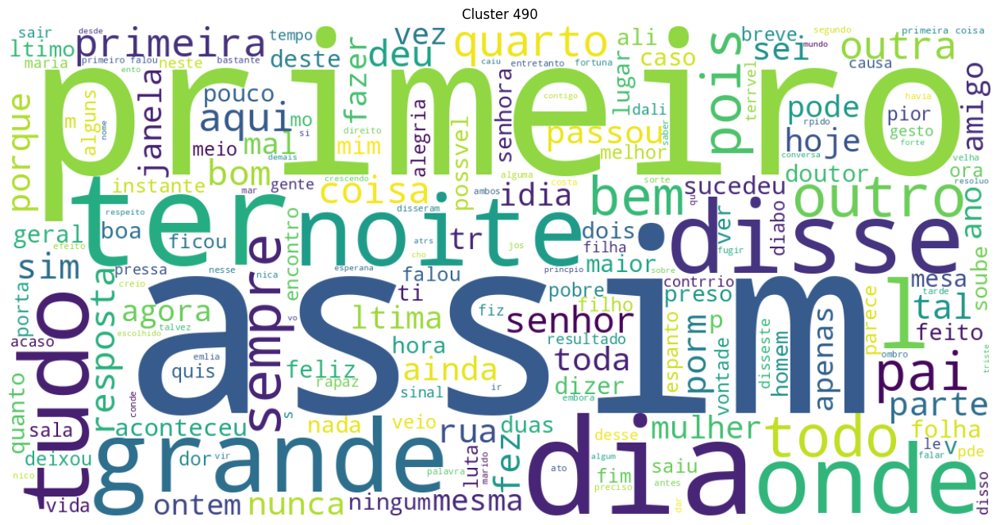

----- Cluster 316 -----
Ao mesmo tempo a sua paixão pela filha crescia.
MARGARIDA O tempo que leva toda flor: uma] tarde, uma manhã.
Não aprovou a idéia: mas não gastou tempo em tentar dissuadir-me.
vem, ó Bela, E o teu querido, Ao Deus Cupido Louvores dar; Pois faz que todos Com igual sorte Do tempo, e morte Possam zombar: Tu por formosa, E ele, Marília, Por te cantar.
- Meu caro senhor, tomo a liberdade de preveni-lo que temos muita pressa e não, podemos perder tempo.
O que da voraz gula o vício adora, Da lauta mesa os seus prazeres fia.
Mas o tempo corre, e as nossas sensações com ele se modificam.
Mas eis aqui um bálsamo divino, que te regenerará o sangue, e te restaurará as forças alquebradas pelo tempo.
Nem por isso durou muito tempo.
Não será fatal que durante esse tempo nenhum ser vivo sentirá dor ou prazer, nem muito nem pouco?
Que lá tem alguns, que não leu, porque o tempo lhe falece e outros porque não merecem tempo, também o creio.
O primitivo explorador vai, afinal, ajusta

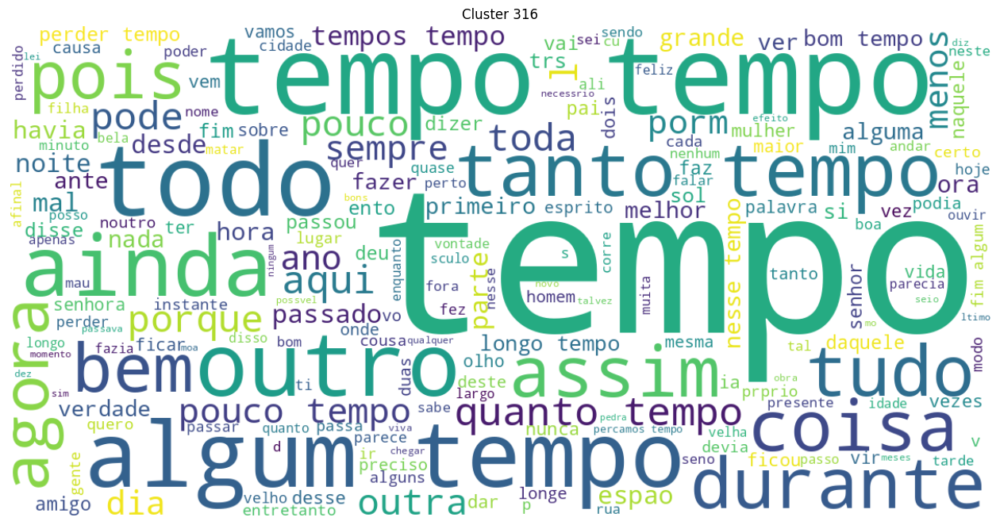

----- Cluster 239 -----
Um estudante a reqüestou e escreveu-lhe; ela mandou-me a carta, e eu respondi em seu lugar.
“Há mistério nisto tudo, dizia ele consigo e relendo a carta de Rosina.
Rasgue a carta que não pode valer-lhe uma recordação, nem representar uma arma."
O criado entregou-lhe a carta.
O Nunes expulsou-o do cartório.
Praza a Deus que esta carta vos seja entregue antes de eu o ser a quem tão mal sabe guardar a fé prometida.” Foi isto a substância da carta, que me fez pôr logo a caminho, sem esperar por mais respostas nem dinheiros, que bem claramente via já que não era a compra dos cavalos, senão só a ânsia de preencher o seu gosto o que obrigara D. Fernando a enviar-me a seu irmão.
- VII - Francisco de Lucena recebeu com espanto semelhante carta.
(Escreve uma carta).
Gomes dobrou a carta e acendeu com ela um charuto, e começou a fumar fazendo esta reflexão profunda: "Onde acharei eu uma herdeira que me queira por marido?"
A mestra fora-me dada por informação do caixeiro e,

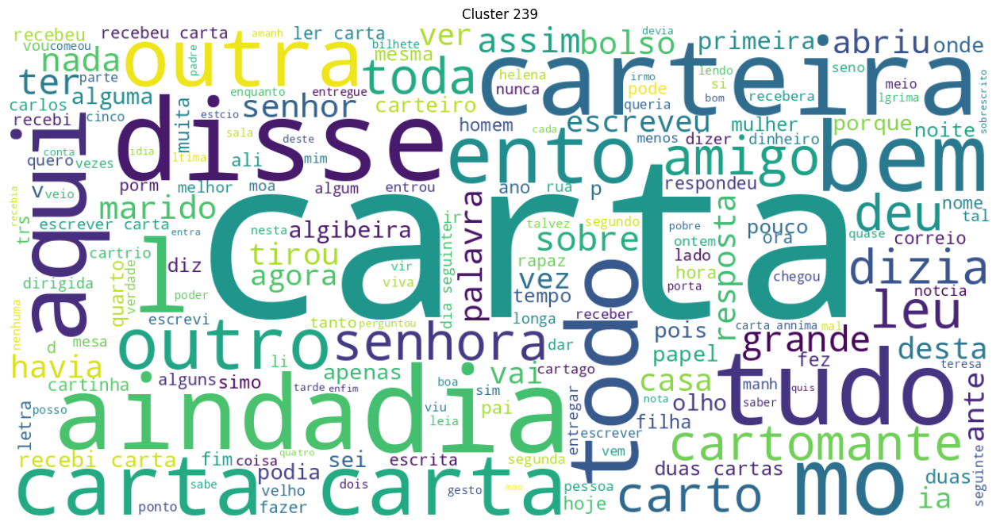

----- Cluster 608 -----
– Transmutação de todos os valores!...
Contigo esqueci a fé nas palavras, os valores, e os grandes nomes.
Os meus olhos estavam no céu.
Lembra-me que desviei o rosto e baixei os olhos ao chão.
Bem-aventurados os que choram.
Os Dois – Que é?
À palavra – morreu – Jeovanito voltou-se rapidamente e disse, arregalando muito os olhos, belos, como são sempre os olhos de uma criança: – Morreu?
Na verdade, a criança tinha o sono duro; nada lhe abria os olhos, nem os fracassos contíguos, nem os beijos de verdade.
Tu és os meus feitiços!
Houve quem lhe proporcionasse ocasião de especular com os seus bens: triplicou-os.
— E os olhos luziam-lhe.
Ainda atentamente relanceou os olhos lentos pelo quarto, para se assegurar do sossego, do silêncio, da penumbra, do conforto.
Os olhos de teu irmão a viram voar para as margens do Mearim, onde estão os aliados dos tupinambás, inimigos de tua e minha raça.
os bastardos.
Os dele estavam assim.


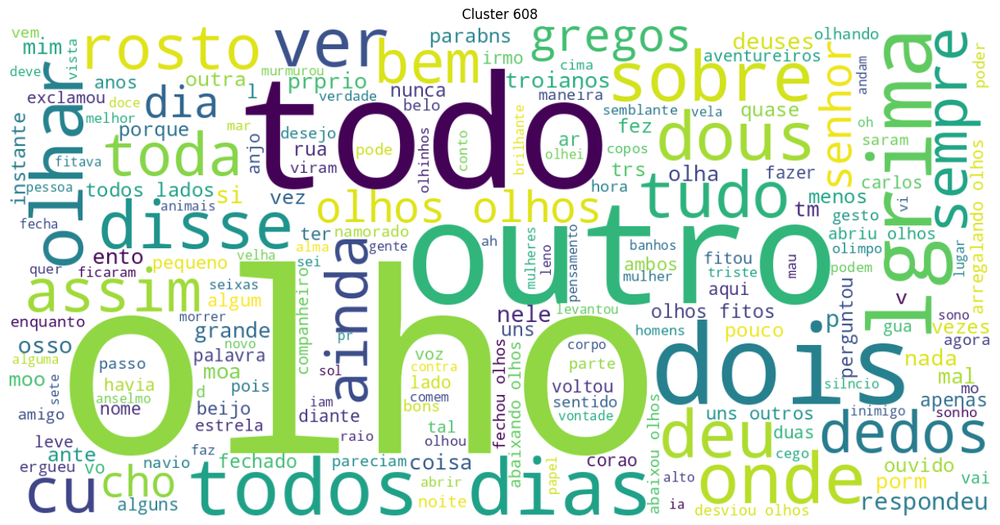

----- Cluster 612 -----
Havia uma grande profusão de luz e os ares estavam doces.
Essa luz, esses sons (jamais ouvi-os) De saber tais desejos me acenderam s4 Que tão pungentes de antes não senti-os.
Justamente o que nós queremos é luz!
E ergueu para a varanda os seus olhos terríveis e desoladores, como blasfêmias de luz.
— Por esta luz que me alumia.
Abolição completa da razão, do tempo, da luz; e inauguração solene do reinado das trevas e da loucura.
Pelo seu andamento é o melhor e o mais fênix de quantos têm saído à luz do mundo.
Desvelam mais que a luz omitem!
Através do arame, na última luz vespertina, eu espiava lá dentro os queridos planetas de vago brilho, como a noite encarcerada ainda.
Em torno dele ia fazer-se aquela luz, que era a ambição da moça, a atmosfera que ela almejava respirar.
Estava radiante; parecia empenhado na direção do almoço, como se tratasse de um trabalho difícil e glorioso.
Mas diante, filho, Quem te há de alumiar, senão as servas?” “Este hóspede, responde

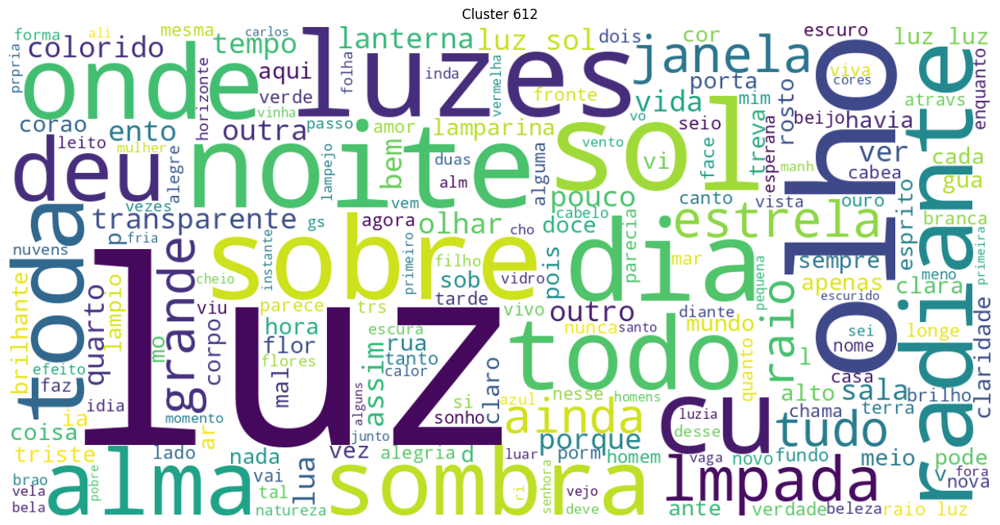

----- Cluster 317 -----
VILA - Você tirou-me o dente do siso.
Ou com os dentes a lingua amputaremos, para passar em pantomima os dias odiosos que nos restam?
Também a ela a doença a engelhara dentro dos trapos nunca mudados, mais escura e torcida que uma cepa arrancada.
Dentro em pouco o sussurro transformou-se em ruído, o ruído em desordem: as senhoras que estavam nos camarotes, recuaram os seus bancos até não poderem ser vistas, espectadores das cadeiras e da platéia levantaram-se ao mesmo tempo como um só homem, e geral gritaria de "fora!
Pego de um folheto, enquanto lá dentro parte um coro louvando a glória de Deus.
- perguntou Malvina voltando-se para dentro.
MARROCOS - Dentro de pouco, ou os homens bendirão meu rico fado, ou serei tido coma amaldiçoado.
Se eu me mexer ou levantar o braço, o melhor dentre vós cairá ao peso de minha repreensão.
Ana Rosa foi ver se tinha, andou remexendo lá por dentro da casa, e voltou com uma segunda.
- Provarei, disse Amaro, tomando um ladrilho em

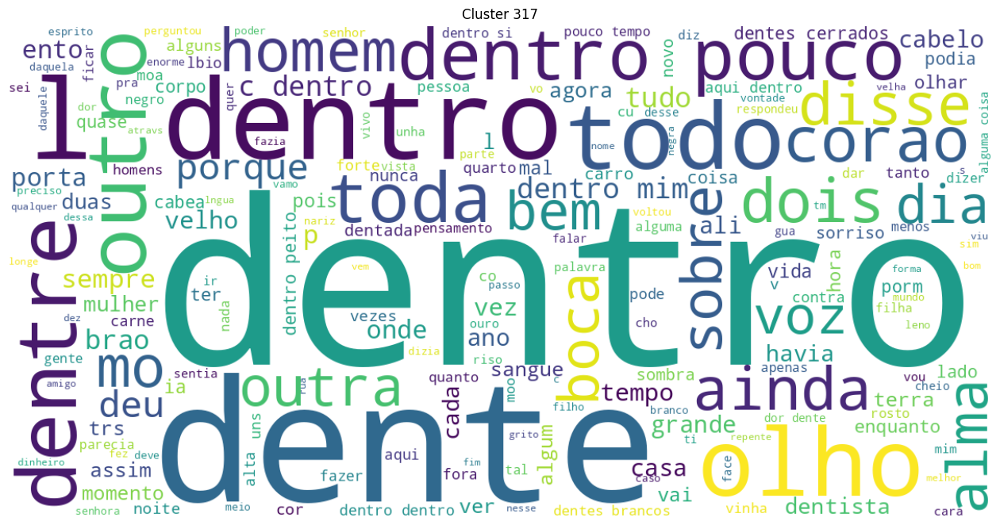

----- Cluster 658 -----
Se estou desperto, venha algum planeta por terra derrubar-me, porque possa dormir o sono eterno.
E vai da terra e vem do curvo firmamento Um murmurar de beijos.
Que fostes a terra em terras onde nunca descerei!
Então, da ilha volante, baixando-se a uma altura 202 conveniente, deitaram-me de cima do terraço uma corrente com uma pequena cadeira suspensa, sobre a qual me sentei, sendo, num momento, içado por meio de um cadernal.
Quanto ao dizeres que, se fores à terra dos cristãos serás minha esposa, eu te prometo que por esposa te aceitarei e to prometo como bom e fiel cristão, e bem deves saber que os cristãos cumprem melhor que os mouros aquilo que prometem.
Queria mostrar-lhe a terra que séculos depois haviam de habitar seus pósteros.
Eram eles proprietários da terra que pisavam, e – com direito exclusivo à sua posse, – tinham porventura o de repelir os invasores europeus que pretendiam turbá-la?
Maria, pobre criança, Que fazes tu sobre a terra?"
- Feliz a terr

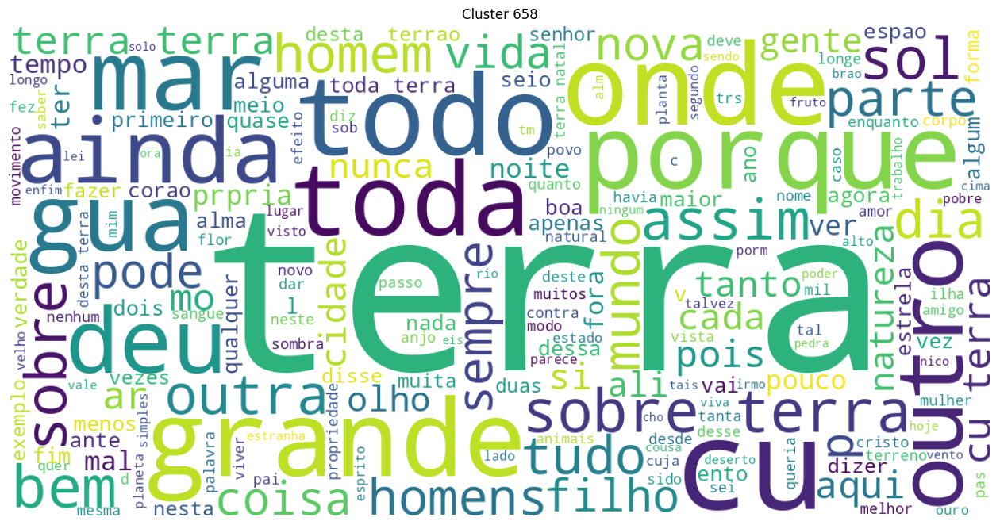

----- Cluster 329 -----
FRAZÃO — Você recebe o dinheiro três dias depois da chegada.
Chegados sendo Ao real de Agamemnon, este arautos Canoros aquecer trípode manda, Para expurgar-se da sangueira Aquiles.
Enfim ele chegou onde queria.
Ainda agora a gente chega, já lhe começam a aparecer cousas de religião!
é chegada a ocasião de mostrar, que é deveras que me quer bem.
Esta o fez entrar na carruagem que já havia chegado, assentou-se junto dele e disse ao cocheiro que tocasse par a Tijuca.
Chegaste a ousar a mala ?
Com a exposição de Cebete cheguei quase a relembrar-me e convencer-me.
Quando chegaste?
Ela mesma, um dia, dissera-lhe, depois de ter estado um momento pensativa: - Tu podias chegar a papa!
Minha irmã acaba de chegar da rua (sete e meia da noite) e me traz a notícia de que um grande prédio em construção no Largo do Rossio acaba de desabar, matando quarenta operários.
110.1 “Chegado aqui ...”: a fonte dos milagres de S. Tomé aqui narrados vem em Barros (III.VII.XI) e abrange as

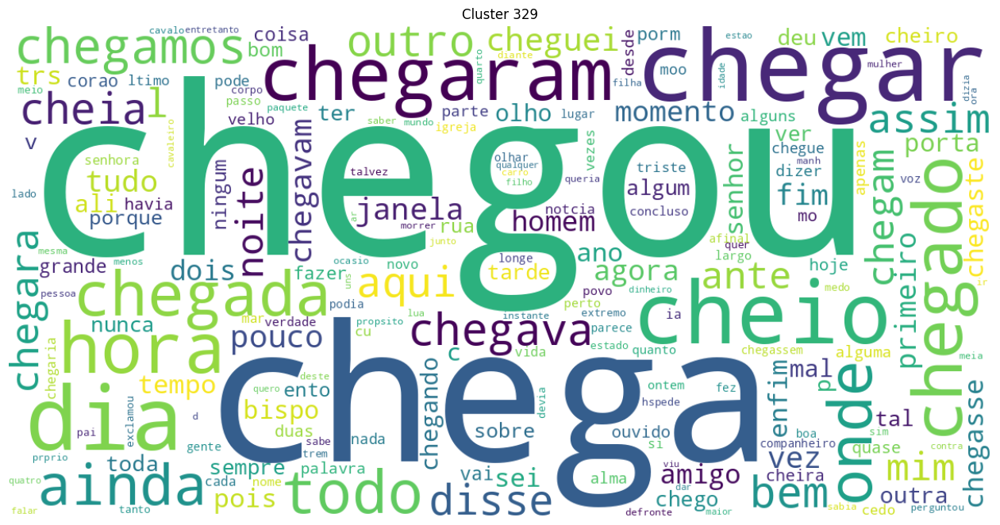

----- Cluster 181 -----
Logo a partir de Camaçari as formações antigas cobrem-se de escassas manchas terciárias, alternando com exíguas bacias cretáceas, revestidas do terreno arenoso de Alagoinha que mal esgarçam, a leste, as emersões calcárias de Inhambupe.
Já existiam compromissos antigos com o Pita.
Mas Netuno Concita as Graias hostes; vem primeiro Aos heróis Teucro e Antíloco e Deipiro, Merion e Leuto, Peneleu e Toas, E exclamou: “Que vergonha, ó flor dos jovens!
Os antigos pintavam assim o Destino, com longas barbas e longas guedelhas, e o alforje às costas contendo as sortes humanas..." - E com efeito ao cabo do pinheiral silencioso, que estiradas réstias de sol docemente douravam - avistou a caleche da Feitosa, parada sob uma carvalha, com o cocheiro fardado de negro dormitando na almofada.
Ele cita, em apoio, um texto antiaristotélico de Clavius, autor de um compêndio de Matemática versado por Descartes.
Quebrai-me as antigas tábuas.
Extinguiu a velha milícia, organizou a nova

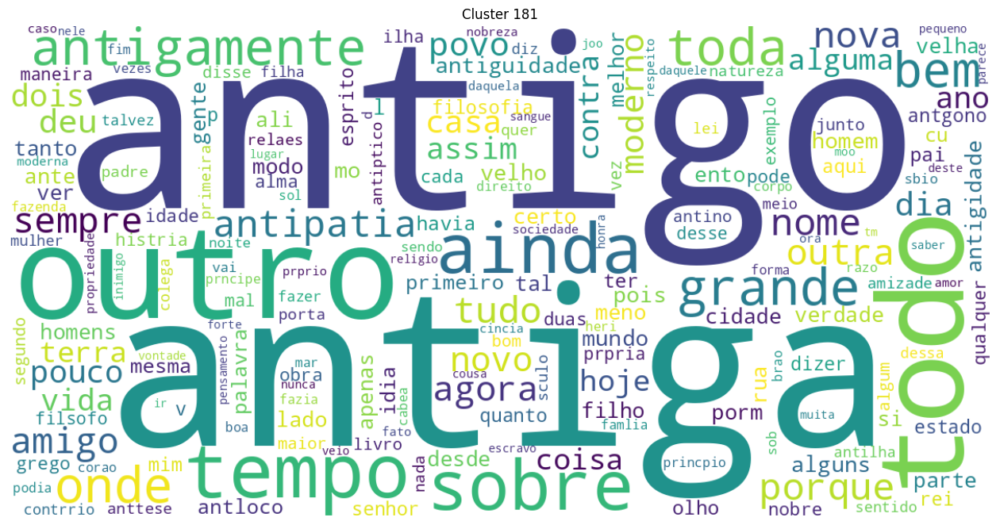

----- Cluster 179 -----
Mas às onze horas ninguém ainda se tinha recolhido para dormir, e Florêncio da Silva tomava disposições e dava ordens para a viagem.
E quando eu seja dormindo Sem luz, sem voz, sem gemido No sono que a dor conforta; Ao consertar tuas tranças No meio das contradanças Diz tu sorrindo: “- Qu’importa?...
Dorme no passado Meu pobre sonho doirado... Esperança que mentiu... Sabem as noites do céu E as luas brancas sem véu Os prantos que derramei!
– Que diabo, não responde... Só se está dormindo.
Dorme, que tudo é vão!
Pode dormir!
Assim era Gregório alimentado, uma vez de manhã cedo, enquanto os pais e a criada estavam ainda a dormir, e outra vez depois de terem todos almoçado, pois os pais faziam uma curta sesta e a irmã podia mandar a criada fazer um ou outro recado.
Dizendo isto, o passageiro de quarenta anos fechou os olhos, e pouco depois deixava cair o livro que tinha na mão: dormia.
há-se de cumprir o juramento a despeito de tantas desconveniências e incomodidad

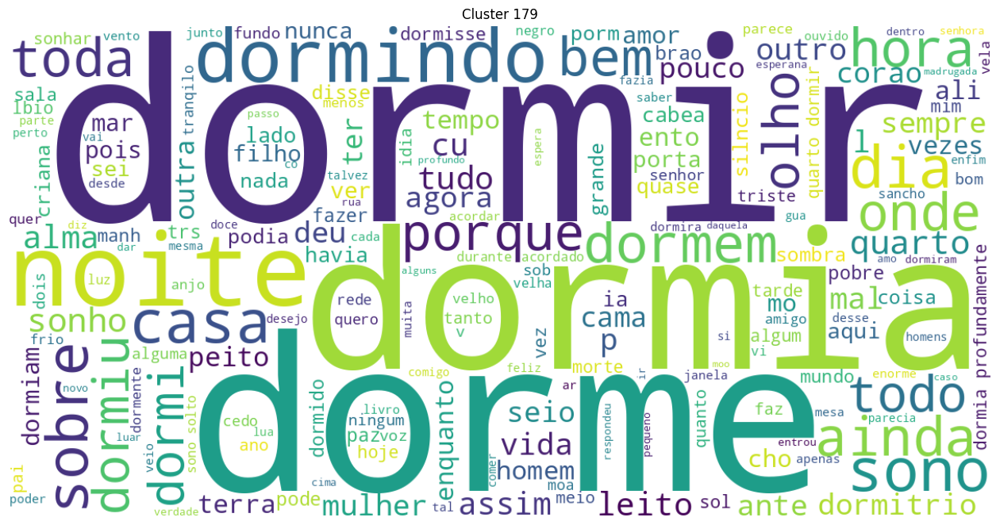

----- Cluster 646 -----
Não precisarei mais, desde essa hora bendita, após trabalhos mil como esses que frustrei, dar por certas ao mundo as coisas que não sei.
3.Transição da forma-valor geral à forma-dinheiro A forma-equivalente geral é uma forma do valor em geral.
Mas como se medem as quantidades de trabalho?
— Se trabalhava!
Trabalho difícil, concordo, e que não é mais profissão, é arte.
Note-se, desde já, a repetição fundamental dos mesmos produtos e das mesmas variedades de trabalho.
(48) É próprio da vaidade o dar valor a muitas coisas, que o não têm, e quase tudo o que a vaidade estima, é vão.
Relação entre o desenvolvimento da forma-valor relativa e o da forma-equivalente A forma-equivalente desenvolve-se simultaneamente e gradualmente com a forma relativa; mas - e é necessário acentuar bem isso -.o desenvolvimento da primeira não é mais que o resultado e a expressão do desenvolvimento da segunda.
Somente pela troca é que os produtos do trabalho adquirem, como valores, uma exi

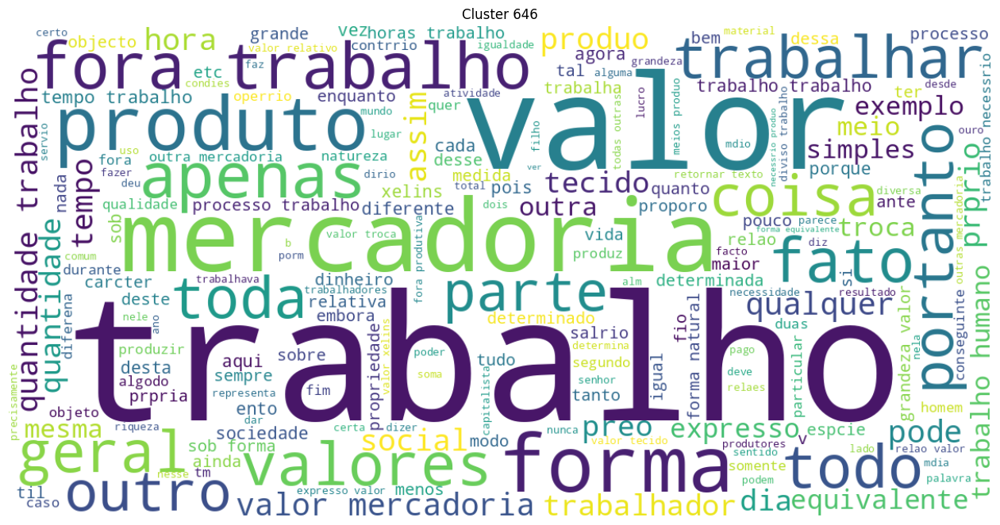

----- Cluster 460 -----
Tinha efeitos largamente generalizados.
Mas tinha uma idéia, caramba!
Mas uma janela, no segundo andar, tinha luz: era o quarto do tio.
D. Flor, porém, tinha-se adiantado com Alina e já abraçava a ingrata, quando o pai aproximou-se.
Se não tinha amor a seu primo, também não lhe tinha aversão.
Está na tinta!
Tinha lá jeito?
Assim emperrado, sem veia, com o fígado combalido?...
Tinha defronte dos  lhos um oficial brasileiro.
Tinha grandes saudades dela; não podia viver muito tempo sem a sua companhia.
s7 Que eu tinha ouvido e que é contrária a esta.” — “Eu te direi a causa, de que é filha A razão que te move essa estranheza; 9o Terás, em vez de névoa, a luz que brilha.
Aí não lhe faltava o sol : tinha−o pontual e generoso todas as manhãs, banhando largamente os terraços, dourando loureirais e mirtos.
— Tínhamos ouvido o seu passo na escada, disse ele.
“Tinha de seguir!
Infelizmente tinham esquecido a matilha do caseiro.


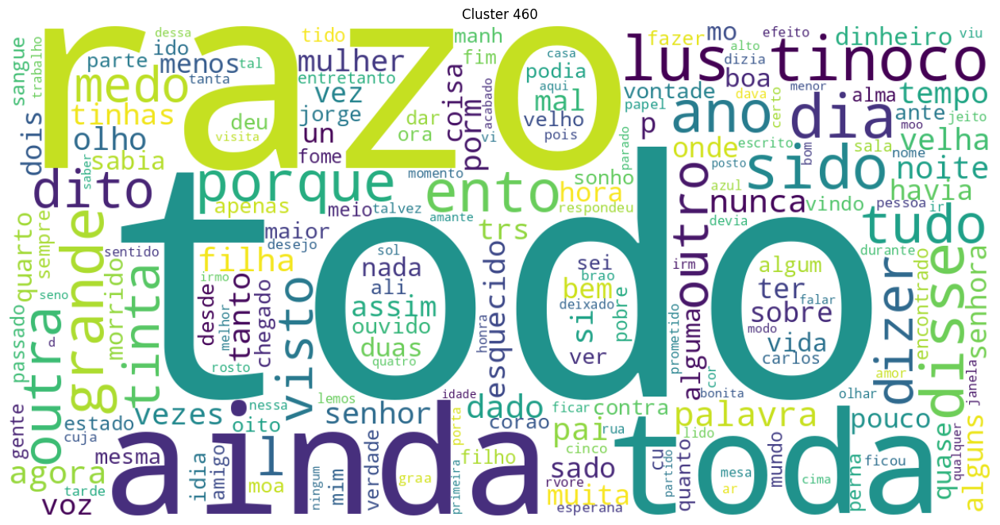

----- Cluster 327 -----
CLARINHA — Eu tenho um meio extraordinário Que pode evitar tamanho desgosto: No momento em que o S’or Vigário Perguntar se caso por gosto, Em vez de “sim”, eu direi”não”!
—Sim, há de ser isso, pensou ele.
Sim, principalmente por ele, visto aceitar como verdadeira a opinião dos que o contraditam.
— Sim, mas não depois de um dia como este!...
-- Viste, sim!
BOATO - É sim, senhor: dali é que nasce a corrupção dos povos.
- Pois então, tornou-me ela, quando formos grandes, havemos de nos casar, sim?
Torna ao teu asilo, longe dessa gente tumultuosa; só na praça pública assediam uma pessoa com o “sim ou não?”.
Depois de lhe responder que sim, emendei-me: --Deus fará o que o senhor quiser.
- De algo, sim.
NICOLAU — Sim, seu pudor?
— Nos trazem, sim; porque eu encomendei um fio de pérolas para ti.
Sim, cumpria ser pai.
Eu, por maldade e riso, teimei que sim, mas dentro de mim acabei concordando com ela.
Sim, chegava a endeusar-me.


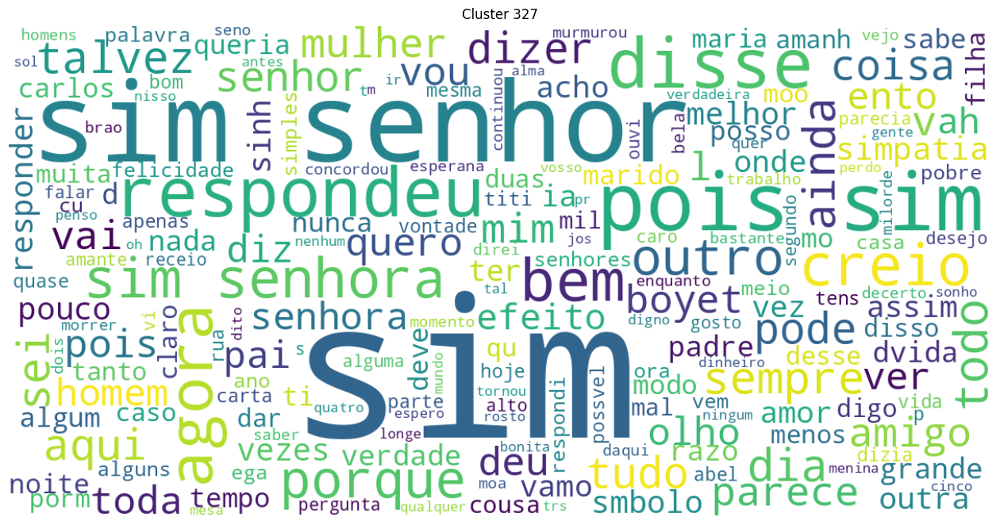

----- Cluster 22 -----
Ao contrário do costume, não saíram da cidade e foram morar em casa do antigo empreiteiro.
Isto mostra que naqueles tempos os costumes não eram melhores que os deste século.
Já na terra, nos braços o levava E num portátil leito ũa rica cama Lhe oferece em que vá (costume usado), Que nos ombros dos homens é levado.
Epicarmo gostava de criticar os costumes bárbaros do povo siciliano e sua tendência para a gula, e seu objetivo como escritor era claramente moralizante.
A escada era dividida em dois lances, dispostos em sentido contrário um do outro; Raimundo chegou ao fim do primeiro lance sufocado, e galgou o segundo de carreira, dando aos diabos o maldito costume de fechar toda a casa, quando ela mais precisa de ar, porque tem dentro um cadáver.
Este costume singular fez-nos rir muito e o consideramos mesmo sofrivelmente estúpido; mas, a todos os nossos epigramas, os utopianos respondiam que nunca se cansariam de admirar a loucura da gente dos países estranhos.
– A

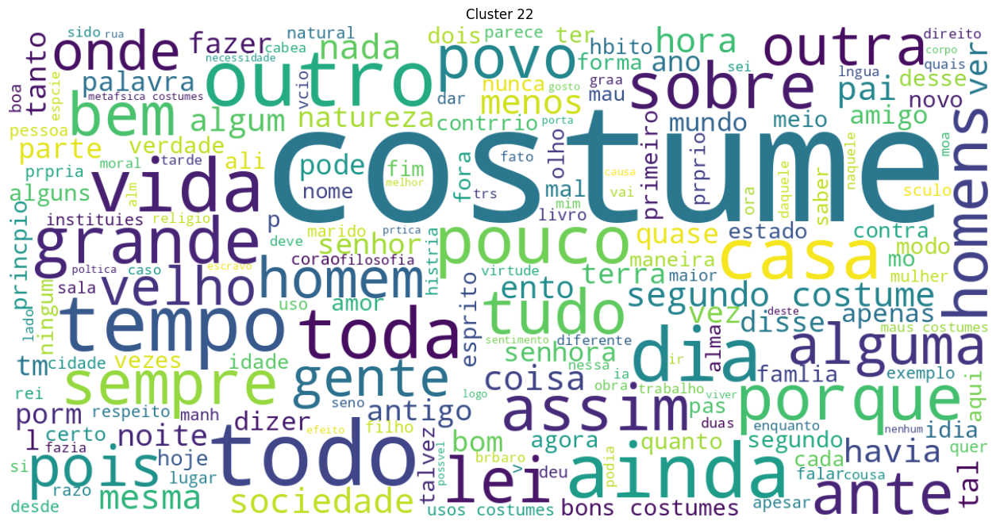

----- Cluster 580 -----
Sonhou que morria, que a alma dela, levada aos ares, voava na direção de uma bela estrela dupla.
O mesmo pensaria a caixa das almas, se pensasse, quando a luva da senhora deixou cair dentro uma pratinha de cinco tostões.
Após — um nome do universo n’alma, Um nome escrito no Panteon da história.
— Deus, observava ele, não quer saber quanto pesam as algibeiras, quer saber quanto pesam as almas.
Quem ouvir e não aprender Quem souber e não ensinar No dia do Juízo A sua alma penará!1 83 Estas velhas quadras, que a tradição guardara, lembravam ao infeliz os primeiros dias da vida atormentada e avivavam-lhe, porventura, os últimos traços da vaidade, no confronto vantajoso com o santo milagreiro por excelência.
- Vão aparecer as almas, avisou Antônio, a cantiga diz: Procuramos a alma de Fulano e de Sicrano e não a encontramos dormindo.
Aí está em que deu tanta pureza de corpo e alma!...
Faço idéia de como ficaria essa pobre alma, e até me admiro de que não visses coisas

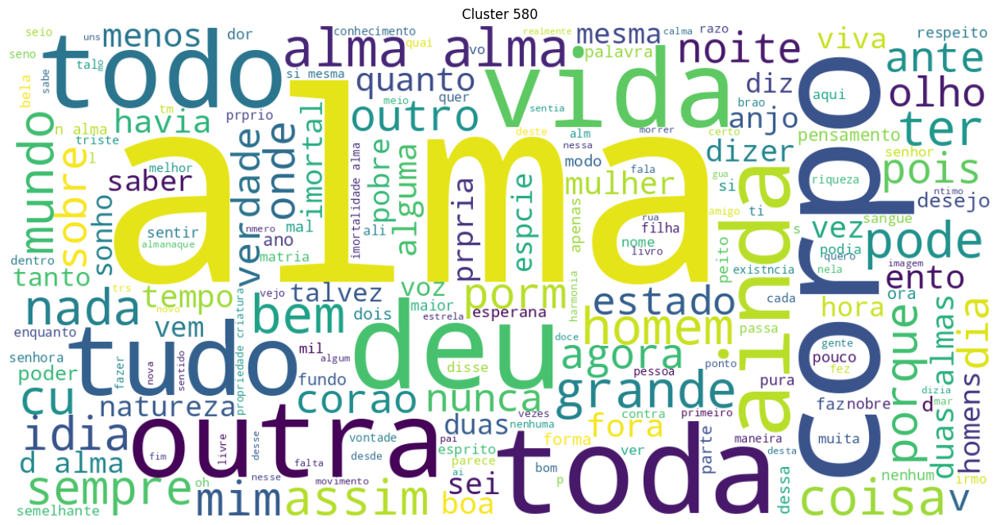

----- Cluster 303 -----
— Não, leva menos!
Mas... — Não tem mais, nem menos!
MENÉIO — O áugur me disse que esta noite vamos ter notícias.
— Mano, apresento-lhe o senhor Nuno Salema, o meu noivo.
Para que mandou entrar?
Mentidos!
- Menina?
– Quinota, teu pai vem aí... mas o que está arresolvido está: amenhã de menhã vamo embora.
Cândida é menina, e as meninas nem sempre sabem ser prudentes.
MENSAGEIRO — Ambos, senhor.
MENINO — Caso eu viva, tio, farei de novo a mesma coisa.
A menina ?
Mande, pois, chamar esse escravo, sem demora.
Um dos lados terá de ser malhado.
— Hei de manter-me na trilha da lealdade, por mais doloroso que seja o conflito entre ela e meu sangue.


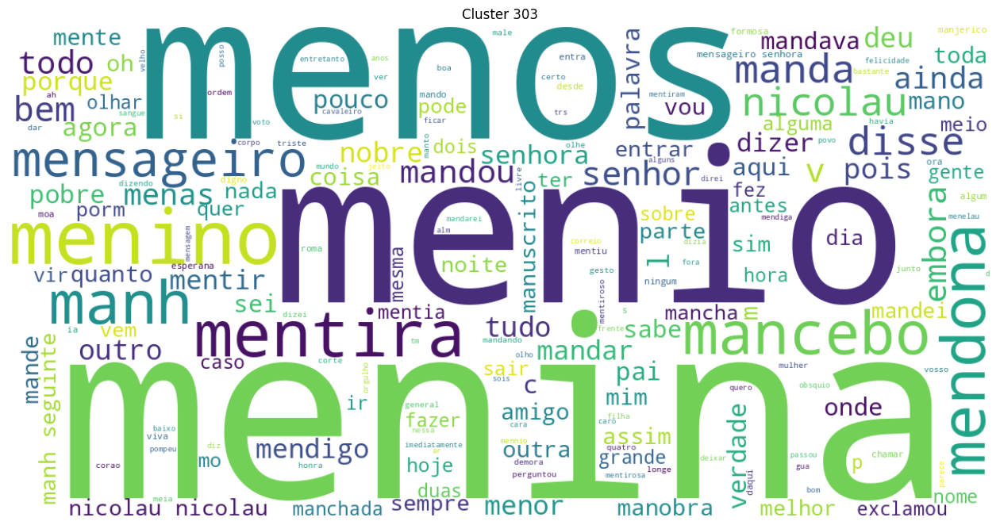

----- Cluster 409 -----
104.
— 104.
— 98.
208—218.
51.
(100).
— 13.
(19) Furtar.
— N. do T.) 70 Cf.
431.
19,5).
224 Garganta.
398.
Págs.
Fifteen men on tbe Dead Man's Chest.


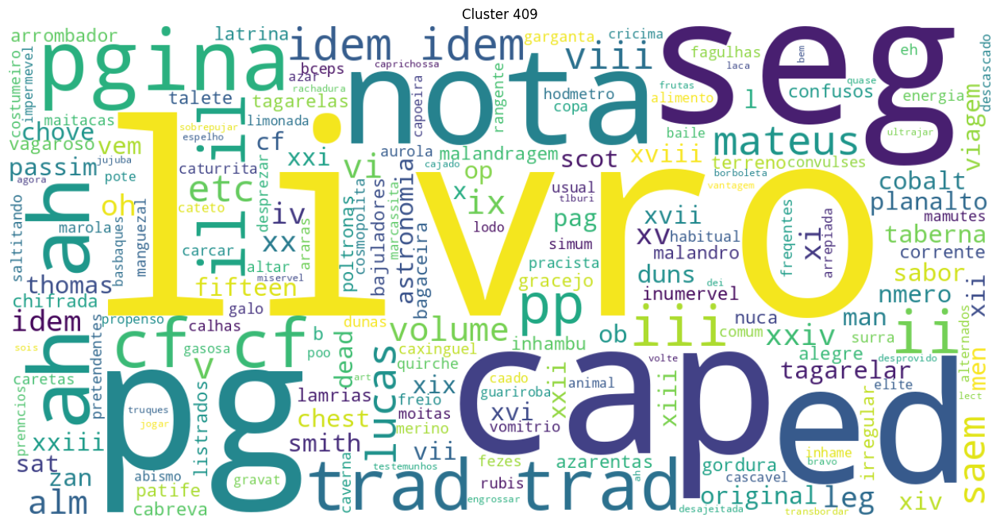

----- Cluster 453 -----
Começamos a passear ao longo da varanda grande.
Passepartout partiu em seguida e percorreu as ruas da cidade.
Passei por aqui e subi para lhe dar um abraço; mas como não está já vou andando.
Não fora o trinar da passarinhada, pressentindo a noite, não fora o urro ameaçador da onça, não fora o guizo das cascavéis.
O Passado!
XI Passado!!
Não escrevo o que lá se passou para me não demorar a dizer tudo, que é muito.
Eu encarno uma existência nova em cada dia que passa.
Amâncio lembrou-se de que lhe prometera acompanhá-lo uma qualquer noite ao Passeio Público.
Passaram-se dois dias.
estava pensando no meu passado.
- Mas há de assim passar a noite?!
Passei a noite em claro.
E não se passa o mesmo em relação ao Uno com os outros?
Apenas Baltasar, cosido com o muro, desaparecera, um vulto assomou do outro lado a passo rápido.


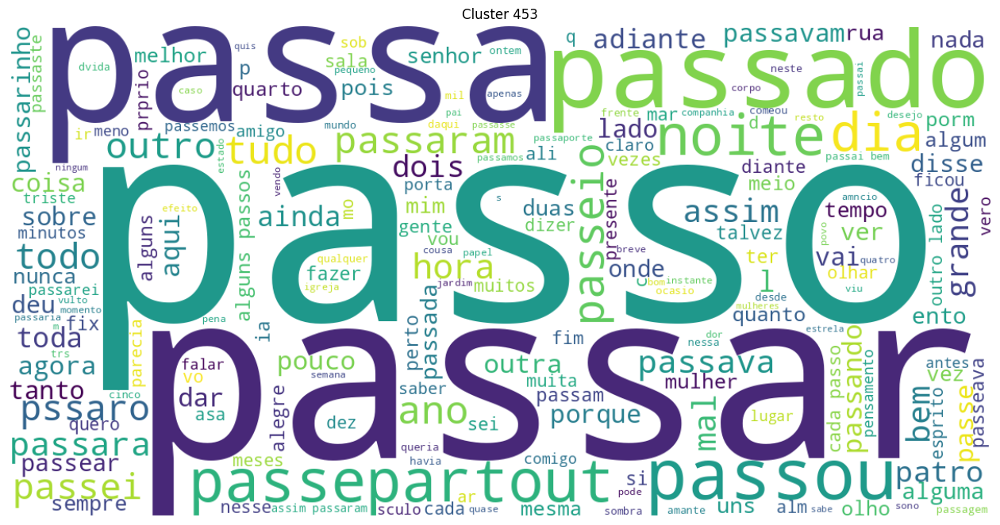

----- Cluster 189 -----
Era uma rapariga de ar inocente, habituada a divertir-se com as coisas sagradas.
 Ó rapariga, o sangue parece que te quer saltar pela cara!
O pai amparava−o ; e o encanto, o cuidado com que o rapaz ia assim guiando os passos do seu filho, impressionou Carlos.
A UMA RAPARIGA À Nice Abre os olhos e encara a vida!
- Quem é vivo sempre aparece, disse Vasconcelos ao avistar o rapaz.
Meneses não se queixou; compreendeu, e disse-o ao rapaz.
Era um belo rapaz, no sentido mais elevado da palavra.
E agora passemos às raposas.
"Faço­me jardineiro neste colégio!" pensou ele, sob a influência dos olhos da rapariga.
- Foi um raio que caiu na família aquele rapaz!...
As raparigas não se podem casar antes dos dezoito anos; os rapazes, antes dos vinte e dois.
O rapaz aceitou e foi, sem prever que esse passo tinha de representar um importante papel na sua vida.
— exclamou a rapariga abrindo os braços aflita.
Como partiu nessa tarde para a província, não soube mais daquela rapari

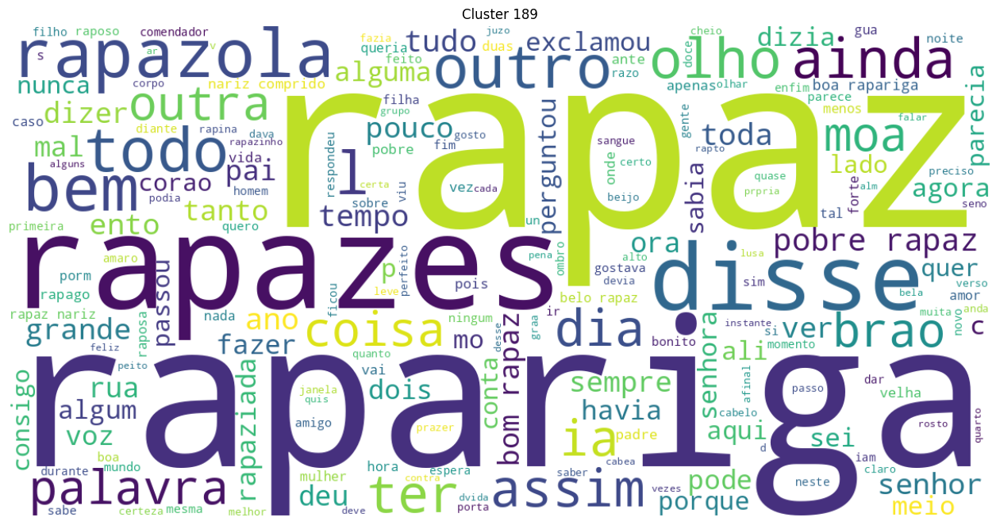

----- Cluster 276 -----
D. Quixote respondeu que lhe perdoava, e o cura foi buscar Sancho, que veio muito humilde e, pondo-se de joelhos, pediu a mão a seu amo, e este deu-lha, e, depois de lha ter deixado beijar, deitou-lhe a bênção, dizendo: — Agora acabarás de conhecer, Sancho filho, que todas as coisas deste castelo são feitas por via de encantamento.
D. Quixote, que sempre foi delicado, condescendeu, e acompanhou-os; ficou Sancho senhor da olha, com mero e misto império; sentou- se à cabeceira da mesa, e sentou-se com ele o vendeiro, que não tinha menos afeição às suas mãos e às suas unhas.
— Tem razão — respondeu D. Quixote.
Os mercadores, Don Quixote, os traficantes, os filhos pervertidos de teu fiel criado Sancho, te admiram.
Com os referidos atavios, e com gentil donaire e presença, saiu D. Quixote para a sala onde o estudante o estava esperando para o entreter, enquanto se punha a mesa; que, pela vinda de tão nobre hóspede, queria a senhora D. Cristina mostrar que sabia e pod

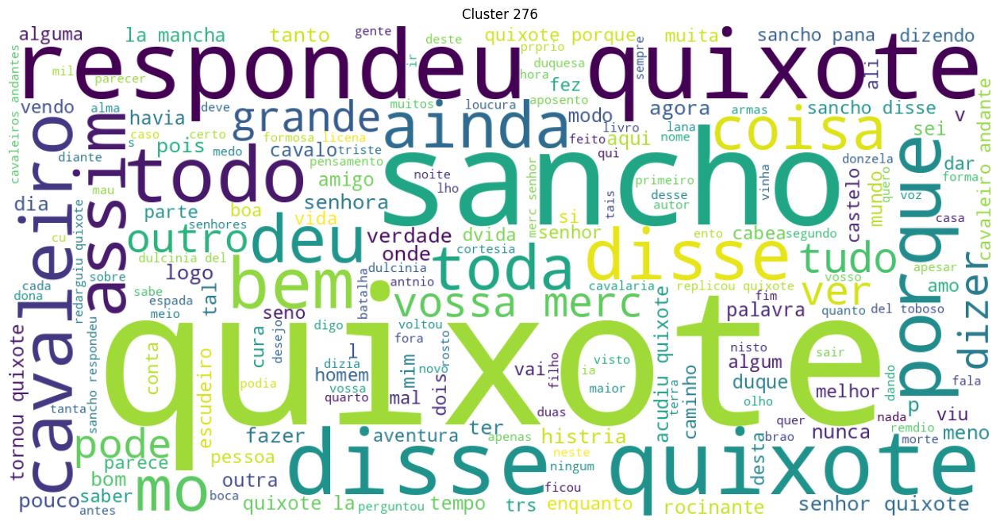

----- Cluster 494 -----
Dos orbes o primeiro, régio manto, o nono céu, isto é, o primeiro móvel, que envolve os oito céus inferiores.
Era a primeira vez que tal ouvia!
assi meu mal do próprio ser primeiro outra cousa nenhüa me consente que este canto que escrevo derradeiro.
Demais, se as palavras dão idéia das cousas, a segunda metade deste século não chega a conhecer a primeira.
Era a primeira vez que Quaresma lhe fazia esse pedido; embora lisonjeado, quis a vaidade profissional que ele, a princípio, se negasse.
ouvi o suspirar da virgem, Dourai-lhe os sonhos no sonhar primeiro!
Primeiro hás de ir tu, entendeste?!
PRIMEIRO SENADOR — A cidade destruir, arrasar tudo.
Com respeito ao terceiro, bastará aceitares que eu incluo nessa rubrica, como unidade, todos os produtos dos dois primeiros, tudo o que nasce para o ser, por efeito da medida e do limite.
PRIMEIRA BRUXA - Fala.
PRIMEIRO EMBAIXADOR — A vista é pavorosa.
Yo lo vi primeiro (?).
11 VII Na primeira convocação do júri o meu nome 

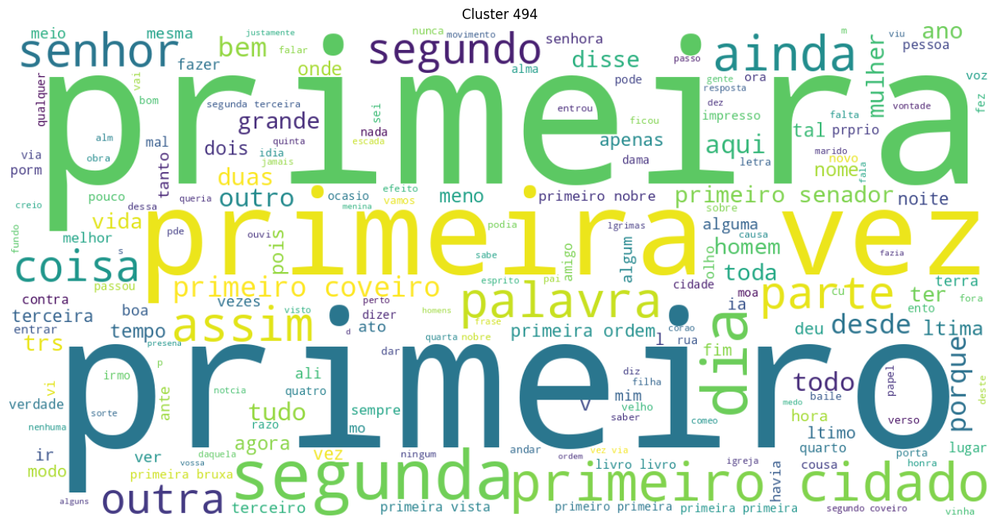

----- Cluster 330 -----
Depois, abraçaram-se.
Mas depois reflectira.
Poucos dias depois, — uma clara e fresca manhã de maio de 1876, — eram seis horas, Pestana sentiu nos dedos um frêmito particular e conhecido.
— Depois contarei tudo.
Vai depois pressurosa despertar seu pai, e com prazenteiro e ingênuo sorriso diz-lhe: — Meu pai, ele vive!
Depois ficaram calados.
Iam depois embora, ou de si mesmos, ou empurrados por ela.
Depois ofereceu, com os beiços já a tremer, toda a sua dedicação.
E depois o rigor com as comidas !
Depois da faísca, a explosão seria fatal.
Depois ia subir, mas voltou ainda.
Depois espreitou debaixo da mesa.
Depois explicou secamente, que tinha estado com a dor.
Soube depois que nunca tinha ido ao parlamento.
Oito dias depois, encontrei-a num baile; creio que chegamos a trocar duas ou três palavras.


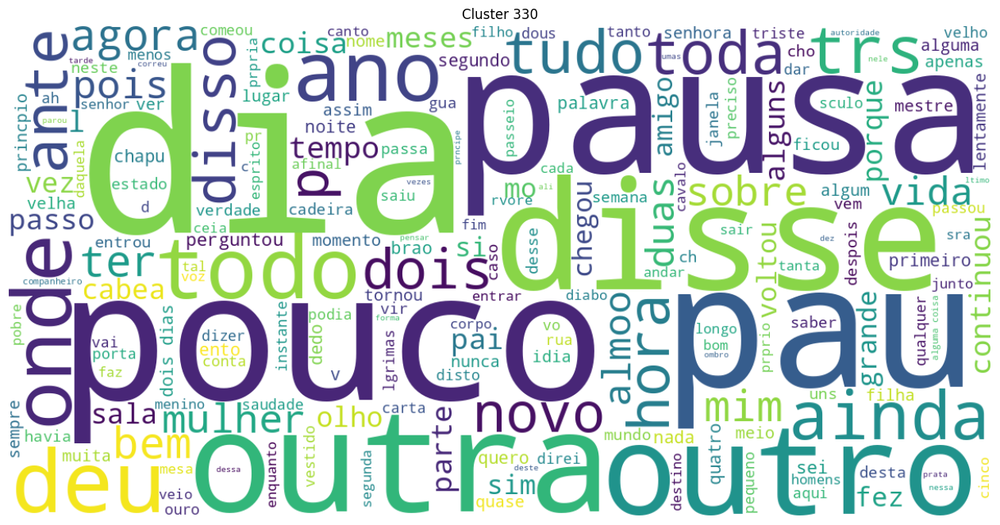

----- Cluster 459 -----
Ela havia compreendido perfeitamente o efeito que produzia no rapaz, e não procurou destruí-lo.
— Mais tarde o saberá... Alguém duvida que a senhora seja uma esposa virtuosa e eu desejo provar o contrário.
Protarco – Evidentemente, a que não tem mistura alguma.
PROTEU — Sei, milorde.
Protarco – Sem dúvida; pois, sem isso não poderia formar-se.
Que prova isto?
Se me provares que errei, não me zangarei, como se deu contigo a meu respeito, mas te inscreverei entre os meus maiores benfeitores.
PROTEU — O tempo há de curar essa tristeza.
PROTEU — Doce amor!
SEBASTIÃO — Pouco importa, uma vez que as viandas nos deixaram, pois fome não nos falta, Sois servidos a provar o que há aqui?
TÚRIO — De minha pretensão, que disse Sílvia, senhor Proteu?
PROTEU — Para servir-vos, ambos nos dispomos.
Demais, subsídio não é vencimento no sentido ordinário: pro labore.
Você sabe que vou lá todo o dia, procurar livros a respeito.
Ao procurar, senhor, a pederneira na janela, encontrei

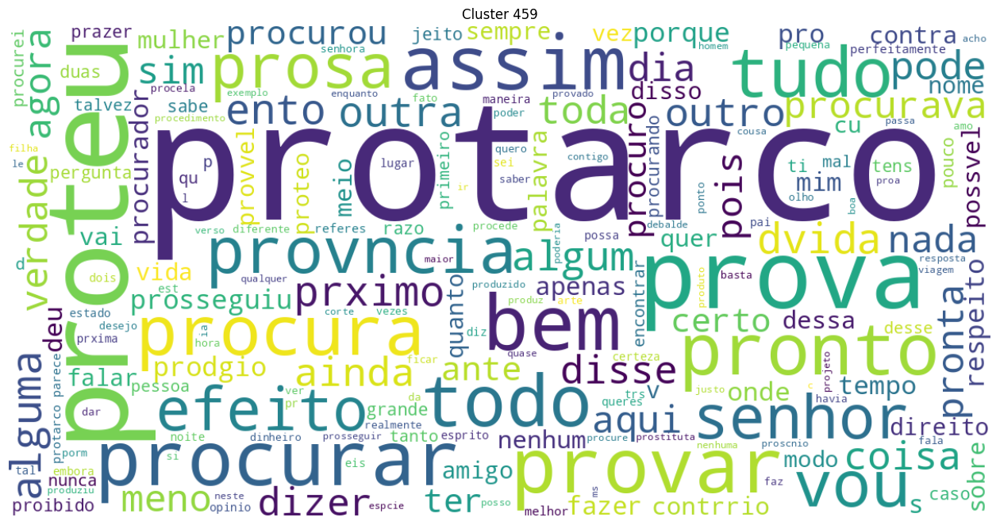

----- Cluster 624 -----
Com flores escrevei, pois, em porfia.
Batidos pelo português, pelo negro e pelo tupi coligados, refluindo ante o número, os indômitos 45 cariris encontraram proteção singular naquele colo duro da terra, escalavrado pelas tormentas, endurado pela ossamenta rígida das pedras, ressequido pelas soalheiras, esvurmando espinheiras e caatingas.
A verdade é que todo ele e o livro são mulheres, e todas as mulheres rosas e flores.
Poucos minutos eram passados; contudo, ela pôde refletir, e coligir os elementos de uma resolução.
Lembro-me, entretanto, que havia flores sobre a mesa, que estava a queimar a sopa; não reparei sequer se esteve presente a filha do diretor.
Adormece num leito de flores Qual donzela formosa embalada Pelos cantos dos seus trovadores; Eu de pé sobre as rochas erguidas Sinto o pranto que manso desliza E repito essas queixas sentidas Que murmura as ondas co’a brisa.
O raio, quando esgalha O ipé secular, atira ao longe Flores, que ha pouco se beijavam 

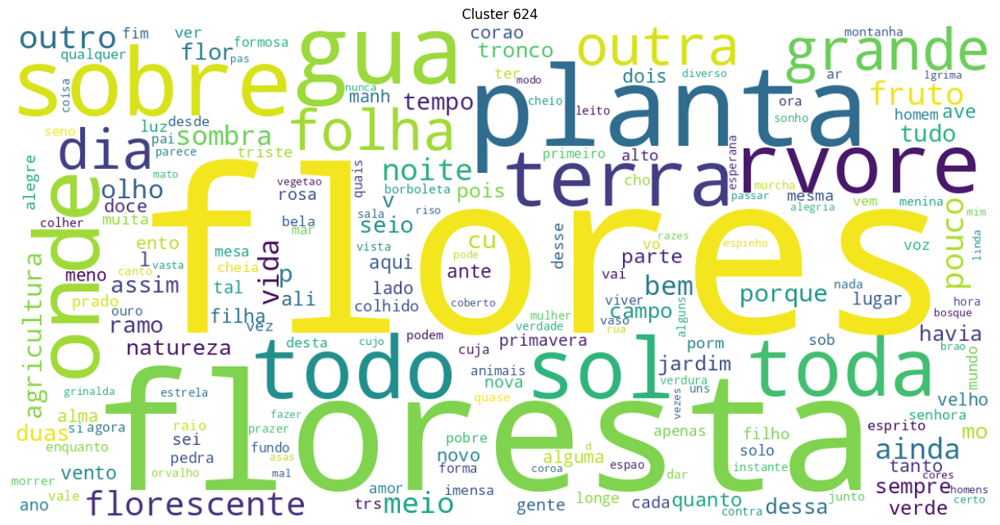

In [63]:
numClusters = len(set([int(x) for x in clusters])) -1

# Imprimir todos os clusters
#clustersToPrint = [i for i in range(numClusters)]
#clustersToPrint.insert(0, -1)

# Imprimir apenas clusters mais populosos
clustersToPrint = [int(x[0]) for x in colorSorted[0:50]]

for numCluster in clustersToPrint:
  indicesCluster = [i for i in range(len(clusters)) if clusters[i] == numCluster]

  sentencasOriginaisDoCluster = [sentencasUtilizadas[idx] for idx in indicesCluster]
  sentencasDoCluster = [sentencasFiltradas[idx] for idx in indicesCluster]

  print('----- '+'Cluster '+str(numCluster)+' -----')
  random.shuffle(sentencasOriginaisDoCluster)
  [print(str(x)) for x in sentencasOriginaisDoCluster[0:15]]

  try:
    printWordCloud(sentencasDoCluster, 'Cluster '+str(numCluster))
  except:
    print('Houve um erro ao construir o gráfico')

# Interpretação dos Clusters

- Cluster 458: relacionado a casa, casamento, esposa.

- Cluster 481: relacionado a amor.

- Cluster 277: Reuniu trechos com pronomes de tratamento (vossa mercê, vossa excelência).

- Cluster 630: Contém muitas ocorrências da palavra "homem".

- Cluster 355: Tema sobre morte.

- Cluster 601: Relacionado a poeta, poema, poesia, verso.

- Cluster 1: Aqui parece ter reunido erros de OCR, que cortaram palavras em sílabas.

- Cluster 422: relação afetiva: filho, filha, pai, velho, amigo.

- Cluster 139: reuniu coisas que possuem "Capítulo", referências ou inícios de sessões.

- Cluster 447: relativo a voltar, retroceder.

- Cluster 10: referências a Sócrates.

- Cluster 513: referência a fogo, calor.

- Cluster 316: relacionado a tempo.

- Cluster 239: relacionado a carta.

- Cluster 612: relacionado a luz, sombra, noite.

- Cluster 329: sentido de chegar

- Cluster 181: relacionado a coisas antigas.

- Cluster 179: relacionado a dormir, noite, casa, sono.

- Cluster 646: relacionado a trabalho, produto, valor, mercadoria.

- Cluster 22: grande frequência da palavra "costume".

- Cluster 580: relacionado a alma e corpo.

- Cluster 409: agrupou números de capítulos, sessões.

- Cluster 453: relacionado a passar o tempo, e passar no sentido de transitar.

- Cluster 189: rapaz, rapariga, rapazola, rapaziada

- Cluster 276: relacionado a Dom Quixote, Sancho.

- Cluster 494: possui grande frequência da palavra primeira, primeiro.

- Cluster 624: relacionado a natureza: flores, floresta, planta, terra, água.

# Save dataframe

In [15]:
# Assume you have these already
indices = np.arange(len(sentencasUtilizadas))  # or some custom IDs

# Create DataFrame
df = pd.DataFrame({
  "index": indices,
  "sentence": sentencasUtilizadas,
  "embedding": list(embeddings),
  "cluster": clusters
})

In [20]:
print(df.shape)
df.head()

(487230, 4)


,index,sentence,embedding,cluster
0,0,14 DE JULHO NA ROÇA Raul Pompéia (A.G. da S.) ...,"[-0.024415258, 0.052543327, -0.024992008, 0.03...",-1
1,1,Ecoa na história com as mesmas vibrações que d...,"[0.0007392184, 0.065883435, -0.081729, 0.02044...",664
2,2,A Marselhesa é o gemido humano chamado às armas.,"[-0.001958345, 0.13307045, -0.073053285, 0.031...",647
3,3,A queda da Bastilha é o pavoroso esboroamento ...,"[0.07455372, 0.090829216, -0.095271945, -0.002...",453
4,4,A pirâmide da opressão tinha por base o grande...,"[0.010334389, -0.0013282513, -0.04966849, 0.00...",-1


In [ ]:
# Save to pickle
df.to_pickle("clustered_embeddings.pkl")